<div class="alert alert-block alert-success">

**scLepr hypothalamus analysis**

analysis

</div>

<div class="alert alert-warning">

**What this notebook does**
    
This notebook analysis the tdtomato sorted Lepr+ cells from the hypothalamus

The downsampled dataset is not regressed for nCounts

</div>  

In [6]:
import numpy as np
import pandas as pd
import scanpy as sc

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
data = './'
results_file = '../rawdata/Lepr_hypothalamus_tomcells_analysis.h5ad'  # the file that will store the analysis results
results_file_down = '../rawdata/Lepr_hypothalamus_tomcells_down_analysis.h5ad'  # the file that will store the analysis results


scanpy==1.5.1 anndata==0.7.1 umap==0.4.4 numpy==1.18.4 scipy==1.4.1 pandas==1.0.3 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 louvain==0.7.0 leidenalg==0.8.0


In [7]:
sc.settings.set_figure_params(dpi=80)

In [8]:
adata = sc.read('../rawdata/Lepr_hypothalamus_tomcells_preprocess.h5ad')
adata_down = sc.read('../rawdata/Lepr_hypothalamus_tomcells_down_preprocess.h5ad')

In [9]:
adata

AnnData object with n_obs × n_vars = 824 × 3772
    obs: 'ERCC_genes', 'n_counts_withERCCmito', 'n_genes', 'n_counts_with_mito', 'percent_mito', 'n_counts', 'percent_ribo', 'percent_coding', 'percent_lincRNA', 'sum_lincRNA', 'percent_antisense', 'sum_antisense', 'percent_miRNA', 'sum_miRNA', 'percent_bidirectional_promoter_lncRNA', 'sum_bidirectional_promoter_lncRNA', 'percent_snoRNA', 'type', 'plate', 'condition', 'chrY_counts', 'chrX_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'normalisation_factor'
    var: 'fullname', 'ENS_names', 'geneid', 'feature', 'chr', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'condition_colors', 'pca', 'plate_colors', 'type_colors

In [10]:
adata_down

AnnData object with n_obs × n_vars = 824 × 1980
    obs: 'ERCC_genes', 'n_counts_withERCCmito', 'n_genes', 'n_counts_with_mito', 'percent_mito', 'n_counts', 'percent_ribo', 'percent_coding', 'percent_lincRNA', 'sum_lincRNA', 'percent_antisense', 'sum_antisense', 'percent_miRNA', 'sum_miRNA', 'percent_bidirectional_promoter_lncRNA', 'sum_bidirectional_promoter_lncRNA', 'percent_snoRNA', 'type', 'plate', 'condition', 'chrY_counts', 'chrX_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'normalisation_factor', 'n_counts_down'
    var: 'fullname', 'ENS_names', 'geneid', 'feature', 'chr', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'condition_colors', 'pca', 'plate_colo

#### Let's have a look at the PCs taht contribute to the variation
    PC1 for the dataset segragates blood vessels
    PC2 is astrocyteglia veruss neurons/interneuron
    PC4 -> pitituary, has Cck as well
    PC5 seem to segrates glia apart, but not very clear
    PC7 is explained best by Agrp

/Users/onurbasak/miniconda3/envs/sc/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 8942 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/onurbasak/miniconda3/envs/sc/lib/python3.7/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 8942 missing from current font.
  font.set_text(s, 0, flags=flags)


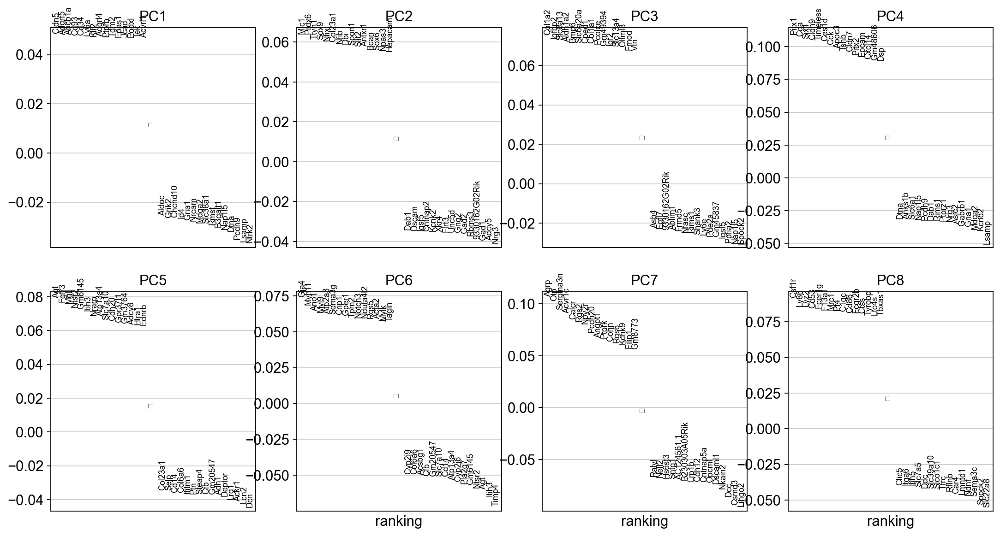

In [11]:
sc.pl.pca_loadings(adata,components='1,2,3,4,5,6,7,8',show=True)

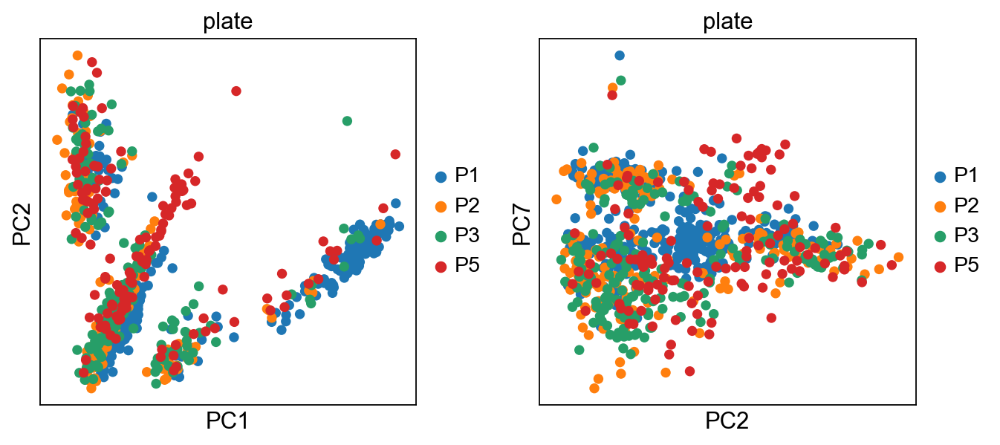

In [12]:
sc.pl.pca(adata,components=['1,2','2,7'],color = 'plate')

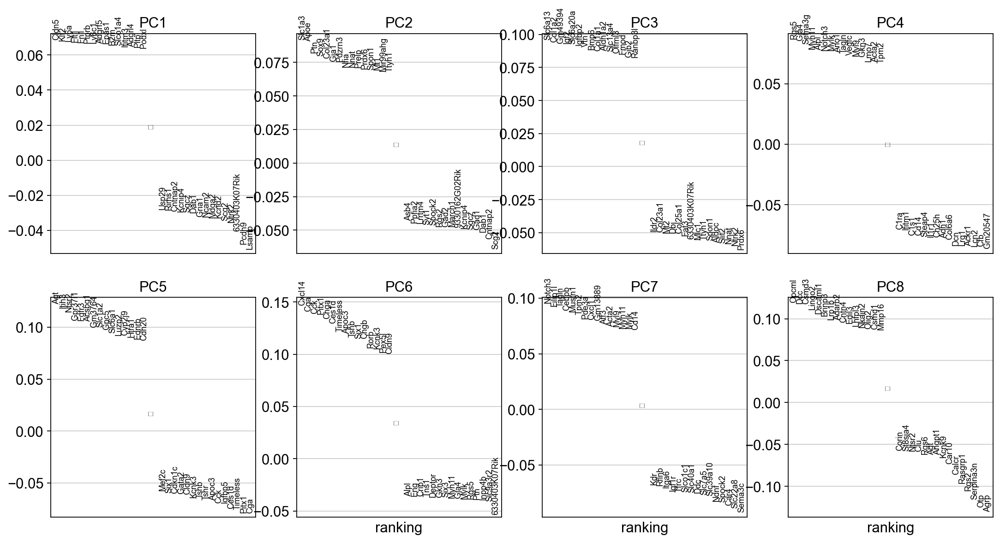

In [13]:
sc.pl.pca_loadings(adata_down,components='1,2,3,4,5,6,7,8')

adata : anndata.AnnData
    …otherwise if `copy=True` it returns or else adds fields to `adata`:

    `.obsm['X_pca']`
         PCA representation of data.
    `.varm['PCs']`
         The principal components containing the loadings.
    `.uns['pca']['variance_ratio']`
         Ratio of explained variance.
    `.uns['pca']['variance']`
         Explained variance, equivalent to the eigenvalues of the
         covariance matrix.

    adata.obsm['X_pca'][823] #varience - Pcs for each cell
    adata.varm['PCs'][3771] # loadings for each gene

In [14]:
# First 15 PCs explain 50% of the variation in the first 50 PCs
(adata.uns['pca']['variance_ratio']/adata.uns['pca']['variance_ratio'].sum())[1:15].sum() 


0.4965721

## Computing the neighborhood graph

Let us compute the neighborhood graph of cells using the PCA representation of the data matrix. You might simply use default values here. For the sake of reproducing Seurat's results, let's take the following values.

In [15]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40) #
sc.pp.neighbors(adata_down, n_neighbors=15, n_pcs=40) #

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


## Embedding the neighborhood graph

In [16]:
sc.tl.umap(adata,spread = 1.5,maxiter =1000,min_dist=1.5)
sc.tl.umap(adata_down,spread = 1.5,maxiter =1000,min_dist=1.5)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


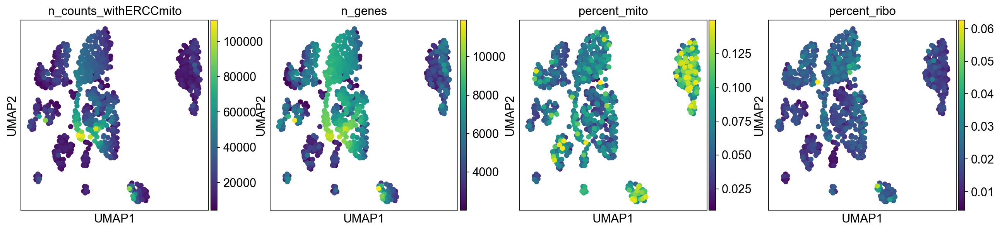

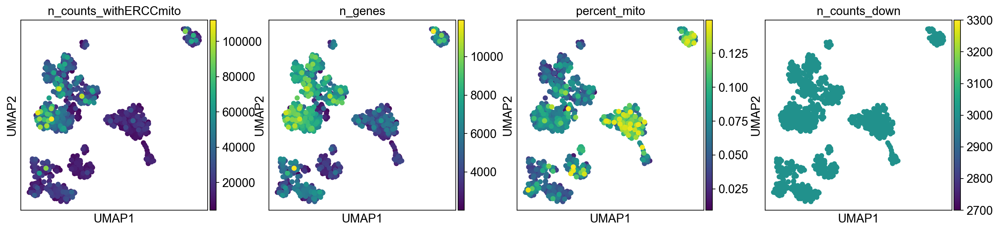

In [17]:
sc.pl.umap(adata, color=['n_counts_withERCCmito','n_genes','percent_mito','percent_ribo'])
sc.pl.umap(adata_down, color=['n_counts_withERCCmito','n_genes','percent_mito','n_counts_down'])


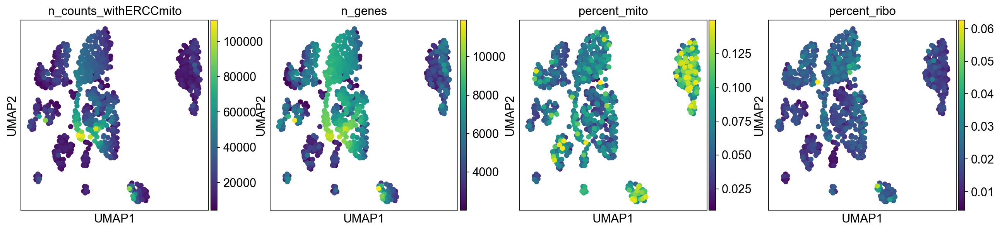

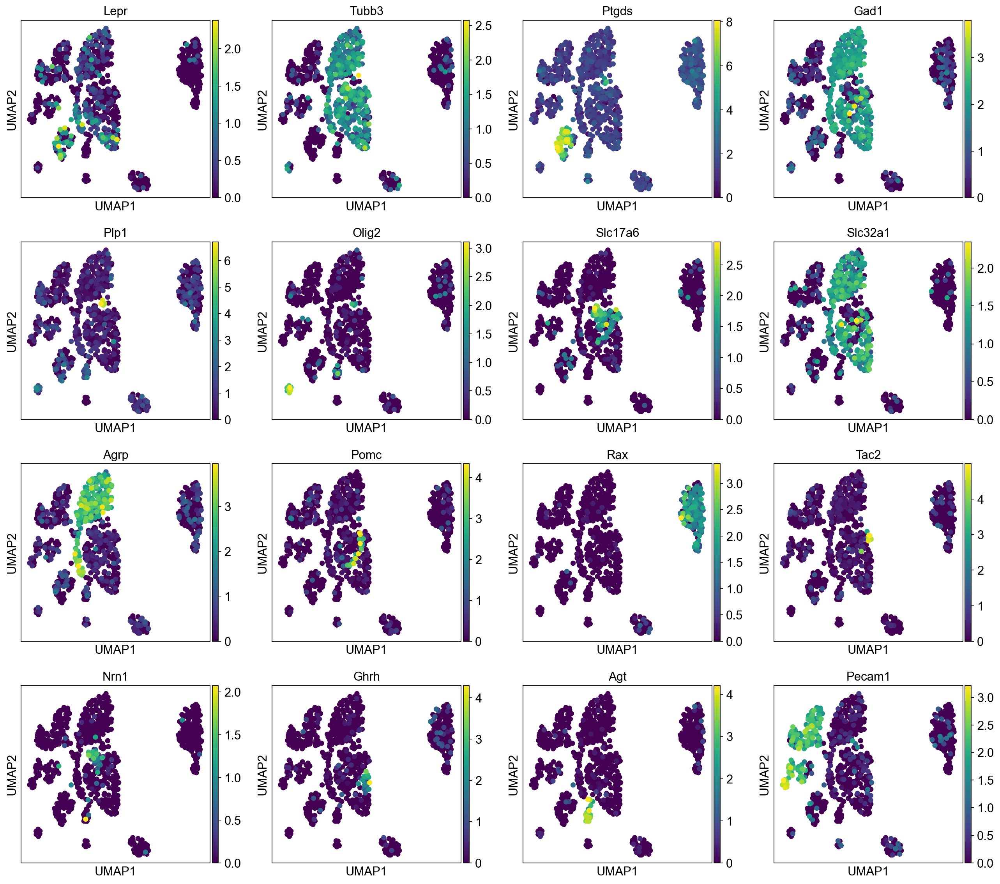

In [18]:
sc.pl.umap(adata, color=['n_counts_withERCCmito','n_genes','percent_mito','percent_ribo'],
                          use_raw=True, save="_tomcells_umap_stats.pdf")
sc.pl.umap(adata, color=['Lepr','Tubb3','Ptgds','Gad1',
                              'Plp1','Olig2','Slc17a6','Slc32a1',
                         'Agrp','Pomc','Rax','Tac2',
                        'Nrn1','Ghrh','Agt','Pecam1'], use_raw=True, save="_tomcells_umap_markers_1.pdf")

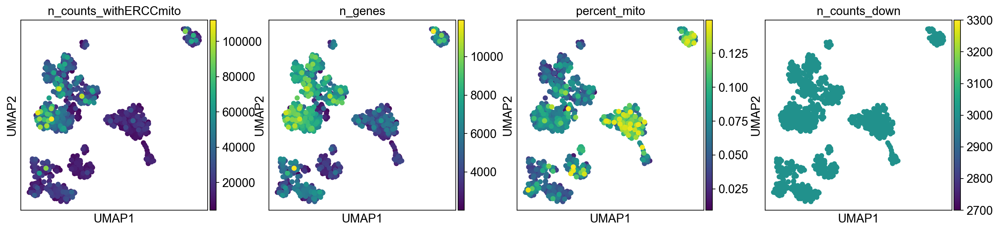

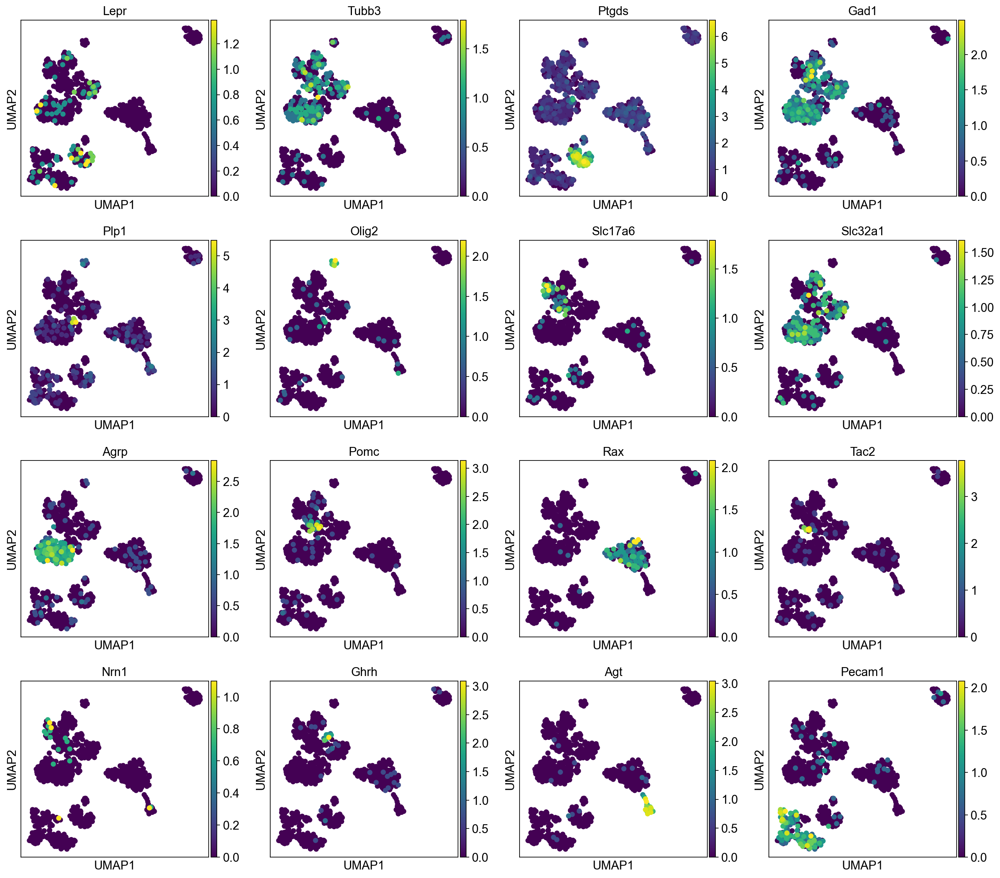

In [19]:
sc.pl.umap(adata_down, color=['n_counts_withERCCmito','n_genes','percent_mito','n_counts_down'],
                         use_raw=True, save="_tomcells_down_umap_stats.pdf")
sc.pl.umap(adata_down, color=['Lepr','Tubb3','Ptgds','Gad1',
                              'Plp1','Olig2','Slc17a6','Slc32a1',
                         'Agrp','Pomc','Rax','Tac2',
                        'Nrn1','Ghrh','Agt','Pecam1'], use_raw=True, save="_tomcells_down_umap_markers_1.pdf")

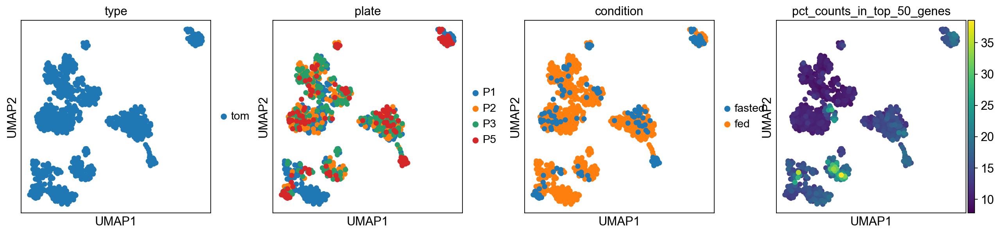

In [20]:
sc.pl.umap(adata_down, color=['type','plate','condition','pct_counts_in_top_50_genes'
                        ], use_raw=True,save="_tomcells_down_populations_umap_1.pdf")#)

In [21]:
sc.tl.tsne(adata,early_exaggeration = 12,learning_rate = 500)
sc.tl.tsne(adata_down,early_exaggeration = 12,learning_rate = 500)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:05)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:05)


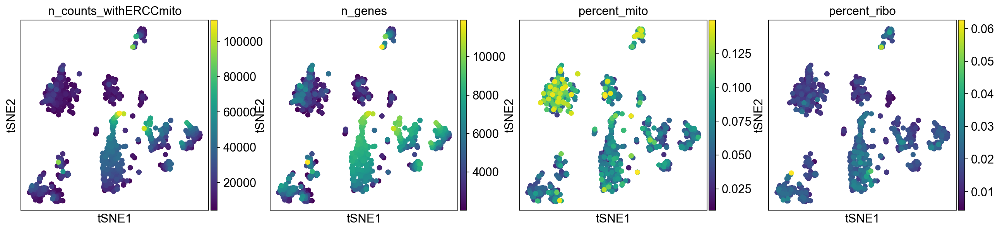

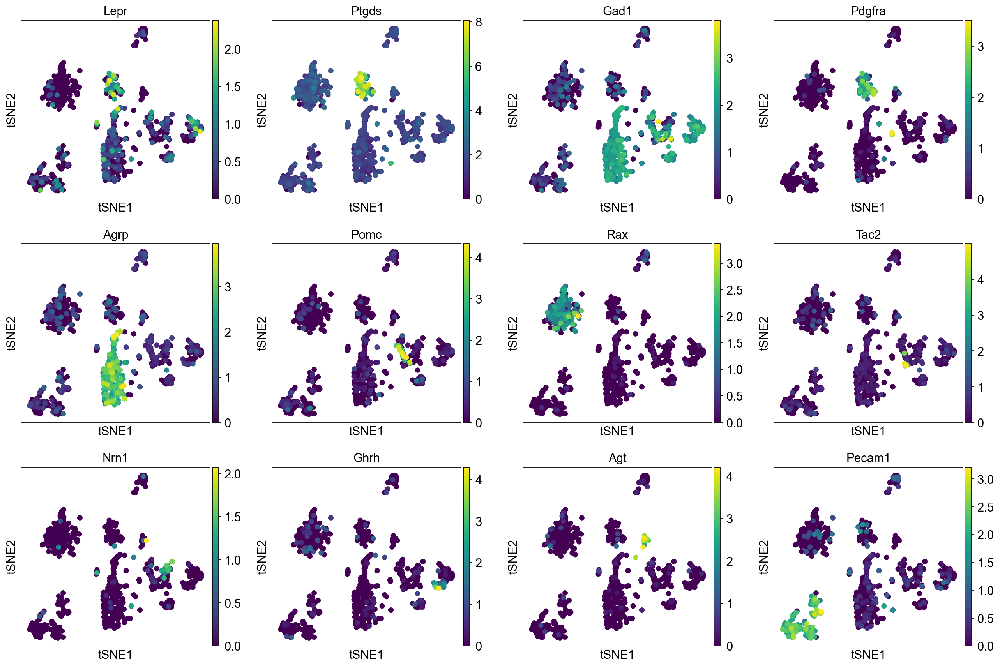

In [22]:
sc.pl.tsne(adata, color= ['n_counts_withERCCmito','n_genes','percent_mito','percent_ribo'], 
            save="_tomcells_tsne_stats.pdf") #s=50,
sc.pl.tsne(adata, color= ['Lepr','Ptgds','Gad1','Pdgfra',
                         'Agrp','Pomc','Rax','Tac2',
                        'Nrn1','Ghrh','Agt','Pecam1'], 
            save="_tomcells_tsne_markers_1.pdf")

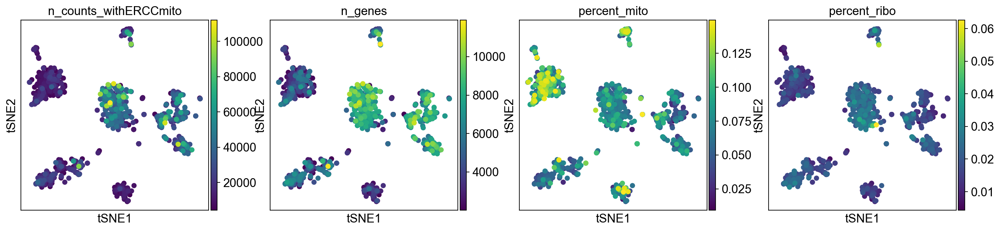

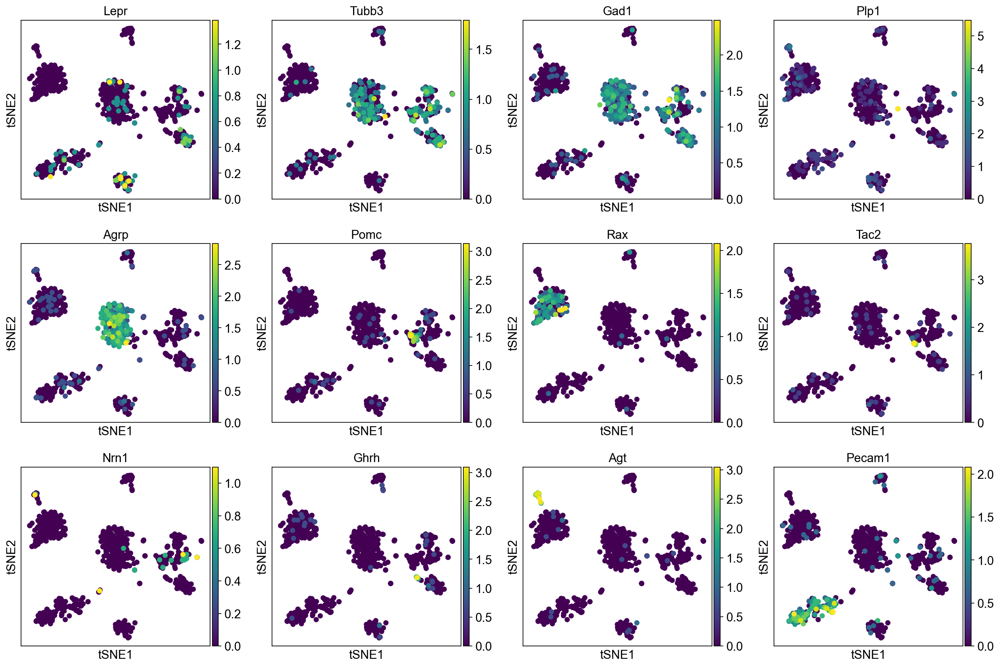

In [23]:
sc.pl.tsne(adata_down, color= ['n_counts_withERCCmito','n_genes','percent_mito','percent_ribo'], 
           save="_tomcells_down_tsne_stats.pdf") #s=50,
sc.pl.tsne(adata_down, color= ['Lepr','Tubb3','Gad1','Plp1',
                         'Agrp','Pomc','Rax','Tac2',
                        'Nrn1','Ghrh','Agt','Pecam1'], 
           save="_tomcells_down_tsne_markers_1.pdf")

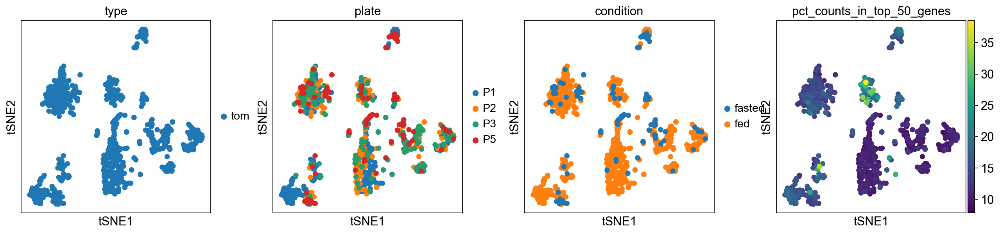

In [24]:
sc.pl.tsne(adata, color=['type','plate','condition','pct_counts_in_top_50_genes'
                        ],save="_tomcells_populations_tsne_1.pdf")#, s=50

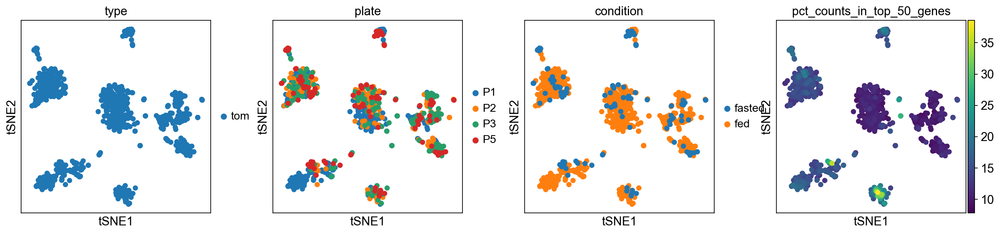

In [25]:
sc.pl.tsne(adata_down, color=['type','plate','condition','pct_counts_in_top_50_genes'
                        ], save="_tomcells_down_populations_tsne_1.pdf")#)

## Clustering the neighborhood graph

In [26]:
sc.tl.leiden(adata,resolution=3)
sc.tl.leiden(adata_down,resolution=3)

running Leiden clustering
    finished: found 29 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 25 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


Plot the clusters, which agree quite well with the result of Seurat.

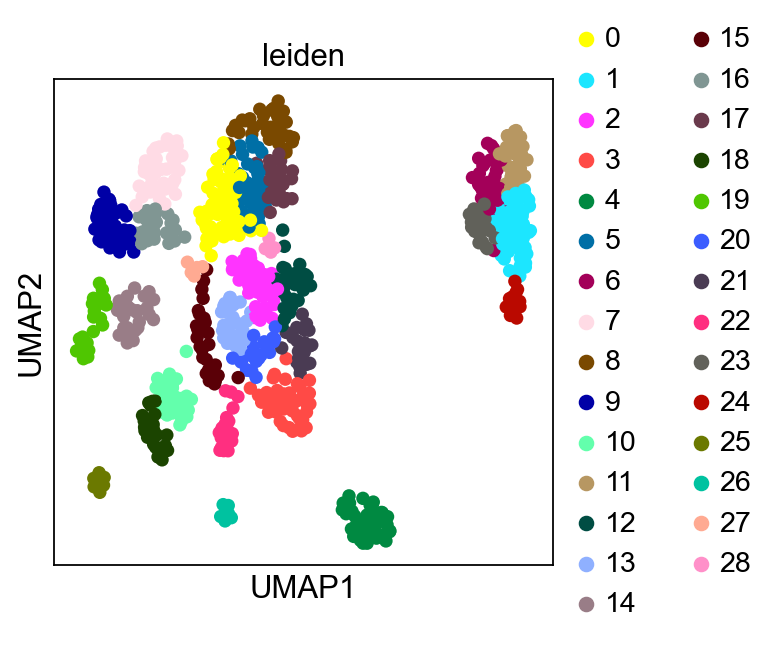

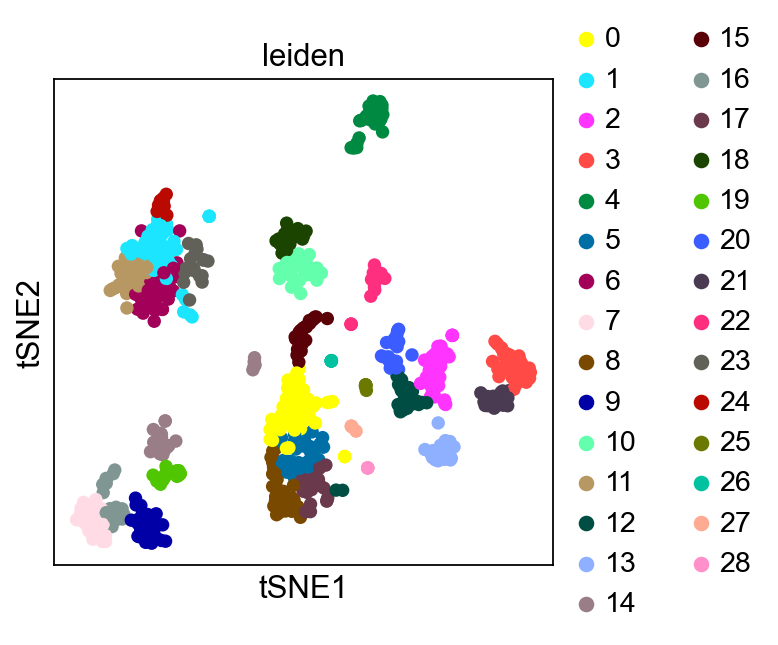

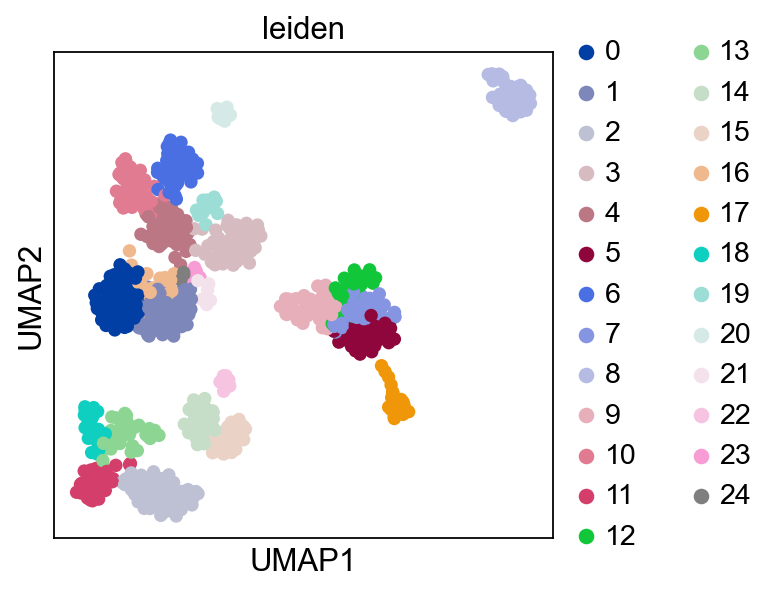

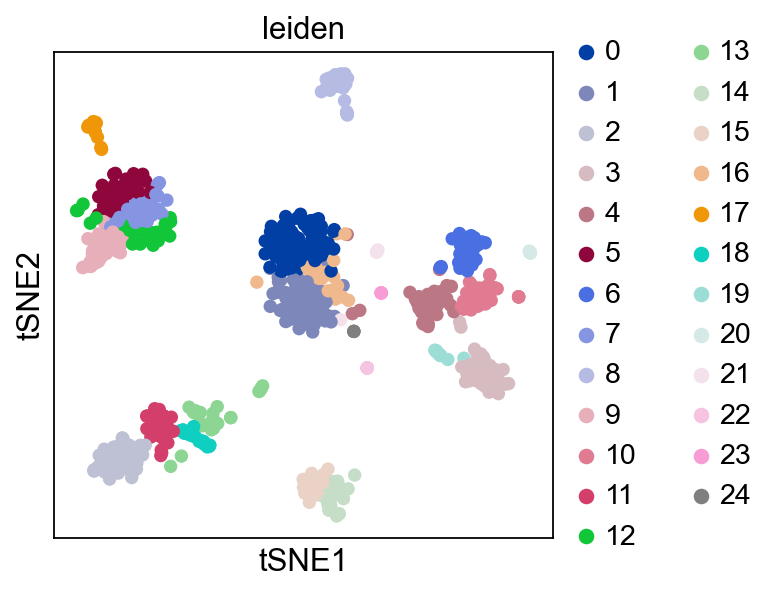

In [27]:
sc.pl.umap(adata, color=['leiden'],save = "_tomcells_louvain_leiden.pdf")
sc.pl.tsne(adata, color= ('leiden'), save = "_tomcells_louvain_leiden.pdf")
sc.pl.umap(adata_down, color=['leiden'],save = "_tomcells_down_louvain_leiden.pdf") #, size = 40
sc.pl.tsne(adata_down, color= ('leiden'), save = "_tomcells_down_louvain_leiden.pdf") #, s=40


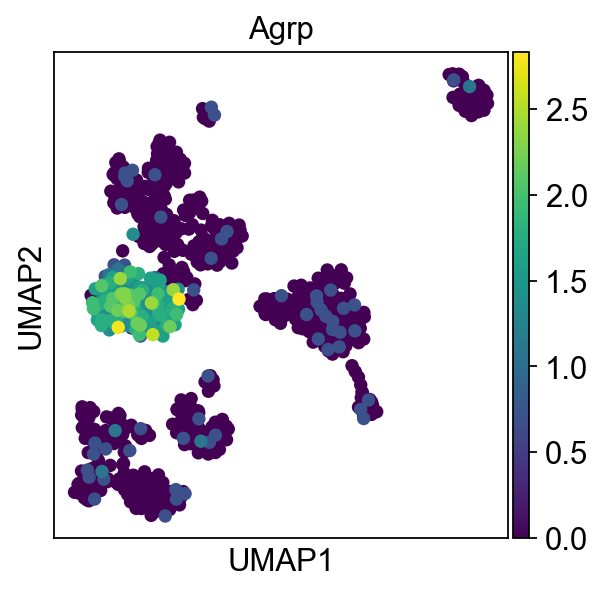

In [28]:
sc.pl.umap(adata_down, color=['Agrp']) #, size = 40


Save the result.

In [29]:
adata.write(results_file)
adata_down.write(results_file_down)

Save the UMAP distribution of cell populations

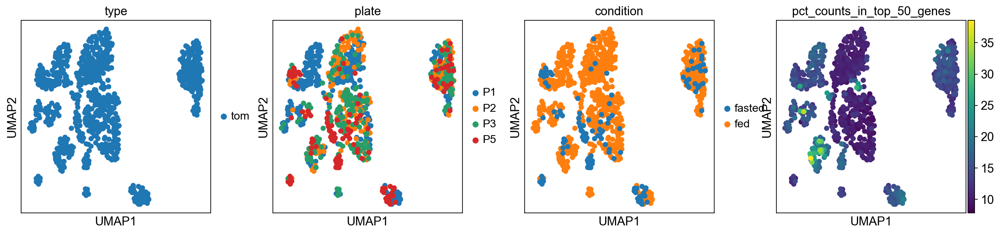

In [30]:
sc.pl.umap(adata, color=['type','plate','condition','pct_counts_in_top_50_genes'
                        ], use_raw=True,save="_tomcells_populations_umap_1.pdf")#)s=50, 

#### Number of cells per cluster

In [31]:
#make a list and add it to uns
cellnumbers = pd.DataFrame(
    {adata_down.obs['leiden'].isin([str(i)]).sum()
        for i in range(25)})
cellnumbers #There are issue here... It is inverted and the cluste numbers are wrong

,0
0,3
1,4
2,6
3,8
4,12
5,20
6,21
7,27
8,30
9,32


## Perform differential gene expression analysis to find marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the `.raw` attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.
Here, I will use wilcoxon, but remember that alternatives exist
Importantly, try **scran** normalisation to increase the power of differential testing

Also while comparing multiple samples, log regression should have an advantage over wilcoxon to identify unique genes in each cluster. Wilcoxon, however, provides more interpretable results

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:07)


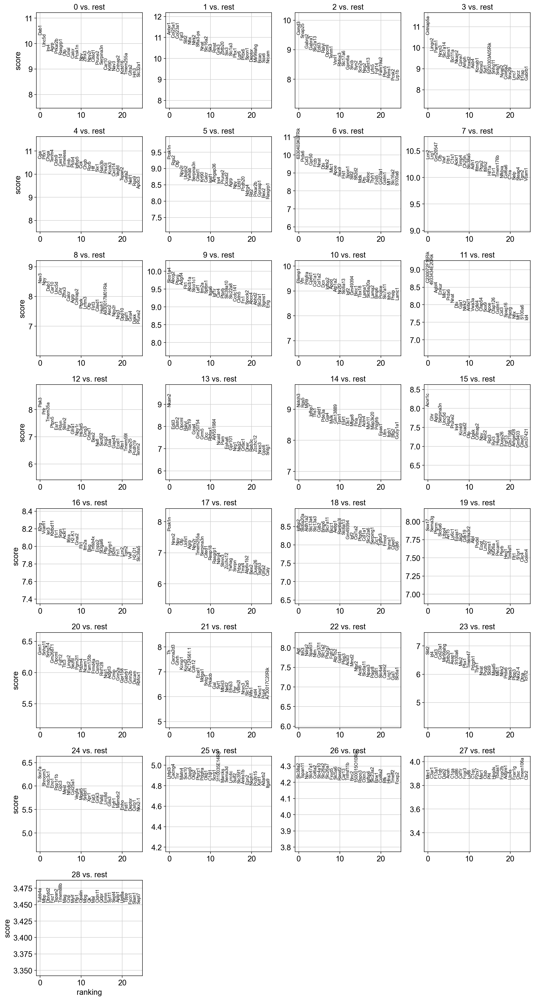

In [32]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False,save = "_tomcells_wilcoxon.pdf")

We can also perform logaritmic regression 'logrog' or overestimated t-test 't-test_overextimate'

In [33]:
#sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False,save = "tomcells_logreg.pdf")

In [34]:
#sc.tl.rank_genes_groups(adata, 'leiden', method='t-test_overestim_var')
#sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False,save = "tomcells_t-test_overestim_var.pdf")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


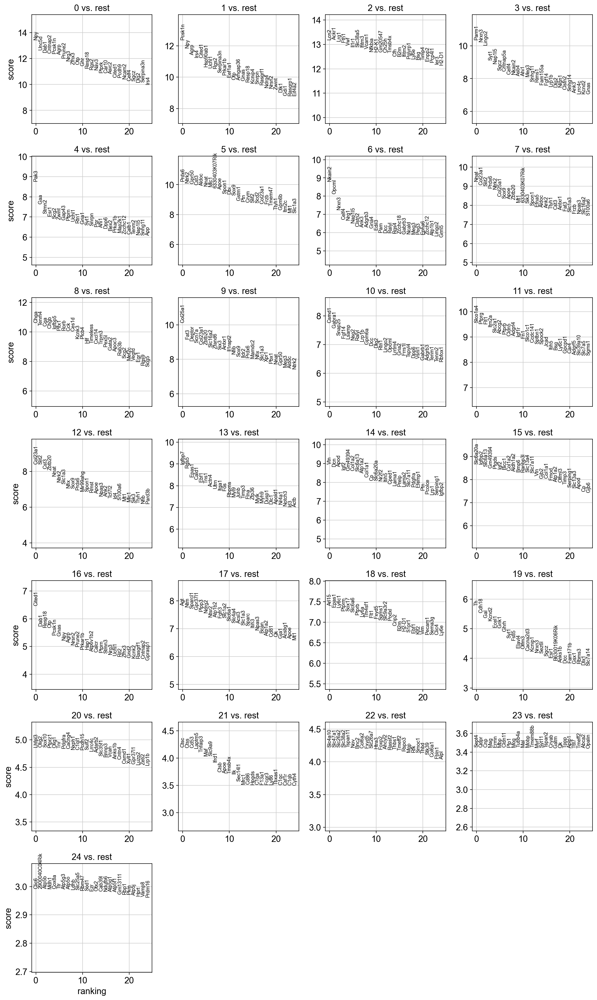

In [35]:
sc.tl.rank_genes_groups(adata_down, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata_down, n_genes=25, sharey=False,save = "_tomcells_down_wilcoxon.pdf")

###### Save the files

In [36]:
adata.write(results_file)
adata_down.write(results_file_down)

In [37]:
sc.settings.verbosity = 2  # reduce the verbosity

###### Now visualise at and save the differential testing results 

Let us also define a list of marker genes for later reference.

In [38]:
marker_genes = ['Mki67','Rax','Tubb3','Lepr',
                'Gad1','Gad2','Gfap','Agt',
                'Slc17a6','Slc32a1','Ndrg4','Crhr2',
                'Agrp','Pomc','Gal','Npy',
                "Rax", "Nrn1", "Pecam1", "Gjd2", 
                "Ghrh", "Col1a2", "Tshb", "Pecam1",
                'Plp1','Olig2',"Col1a2","Ptgds"
               ]

Show the 10 top ranked genes per cluster 0, 1, ..., 7 in a dataframe.

In [39]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
0,Dab1,Antxr1,Csmd3,Cntnap5a,Cga,Pcsk1n,6330403K07Rik,Lcn2,Nav3,Slco1a4,...,Sox17,Grm1,Th,Agt,Slit2,Scn7a,Lhfpl3,Slc38a2,Mrc1,Tubb4a
1,Unc5d,Col25a1,Snap25,Lingo2,Pitx1,Rgs2,Prdx6,Lrg1,Npy,Abcg2,...,Sema3g,Snhg11,Cacna2d3,Itih3,Id4,Shroom3,Cacng4,Tspan11,C3ar1,Mbp
2,Irs4,Col23a1,Gabrg2,Parm1,Chga,Otp,Cst3,Gm20547,Dab1,Ptprg,...,Ptprm,Snhg14,Ghrh,Ndrg2,Cst3,Fndc3c1,Tnr,Nov,F13a1,Dbndd2
3,Agrp,Fat3,Gabra1,Nrxn3,Tenm4,Npy2r,Gpr50,Cfb,Car10,Adgrl4,...,Slc6a6,Gm26871,Kcnip1,Sparcl1,Col23a1,Eno1,Matn4,Slc47a1,C1qb,Fez1
4,Prkar2b,Slit2,Slc2a13,Slc7a14,Cldn9,Ubqln2,Frzb,Vwf,Unc5d,Flt1,...,Ltbp4,Opcml,Kcnd2,Ntm,Mir99ahg,Ppp1r1b,Sox10,Col6a2,Dab2,Tspan2


In [40]:
pd.DataFrame(adata_down.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
0,Npy,Pcsk1n,Lcn2,Parm1,Pak3,Prdx6,Nkain2,Nnat,Chga,Col25a1,...,Slc6a20a,Cited1,Agt,Arl15,Th,Lhfpl3,Ctsc,Slc4a10,Sept4,Clic6
1,Unc5d,Npy,Ackr1,Nrxn3,Gaa,Ntrk2,Opcml,Col23a1,Tenm4,Fat3,...,Igfbp2,Dab1,Ntm,Epas1,Cdh18,Olig2,Ctss,Slc47a1,Qdpr,2900040C04Rik
2,Dab1,Agrp,Lrg1,Lingo2,Stmn2,Gpr50,Nrxn3,Slit2,Cga,Deptor,...,Slc6a13,Resp18,Sparcl1,Ly6c1,Gal,Sox10,Cd53,Slc26a2,Cnp,Atp5b
3,Cntnap2,Irs4,Fth1,Syt1,Esr1,Cst3,Celf4,Prdx6,Chgb,Scn7a,...,Gm49394,Otp,Gpr37l1,Ptprm,Kcnd2,Ptprz1,Laptm5,Slc38a2,Mag,Mdh1
4,Pcsk1n,Cited1,Vwf,Nap1l5,Scg2,Aldoc,Nrg1,Ntrk2,Igfbp5,Col23a1,...,Ptgds,Pcsk1n,Plpp3,Sox17,Ecel1,Olig1,Tnfaip3,Tspan11,Ermn,Cox8a


Get a table with the scores and groups.

In [41]:
result = adata_down.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).head(5) #pvals

,0_n,0_s,0_l,0_p,1_n,1_s,1_l,1_p,2_n,2_s,...,22_l,22_p,23_n,23_s,23_l,23_p,24_n,24_s,24_l,24_p
0,Npy,13.463666,2.709220,7.561015e-37,Pcsk1n,12.393888,2.446285,8.333100e-31,Lcn2,13.191601,...,6.440936,0.05087,Sept4,3.453588,6.209528,0.474323,Clic6,2.992718,9.896861,1.0
1,Unc5d,12.669222,2.868043,1.293849e-32,Npy,11.868583,2.434078,2.546412e-28,Ackr1,13.181686,...,11.474501,0.05087,Qdpr,3.453588,5.352405,0.474323,2900040C04Rik,2.992718,31.396044,1.0
2,Dab1,12.476056,2.899371,9.933703e-32,Agrp,11.417128,3.439902,3.382113e-26,Lrg1,13.127432,...,8.039049,0.05087,Cnp,3.453588,7.269686,0.474323,Atp5b,2.992718,3.338616,1.0
3,Cntnap2,12.422917,2.753555,1.449803e-31,Irs4,11.247421,2.872603,1.450150e-25,Fth1,13.081989,...,5.830980,0.05087,Mag,3.453588,7.641084,0.474323,Mdh1,2.992718,3.650343,1.0
4,Pcsk1n,12.395869,2.294706,1.625939e-31,Cited1,11.244892,2.876099,1.450150e-25,Vwf,12.953651,...,10.821083,0.05087,Ermn,3.453588,9.115159,0.474323,Cox8a,2.992718,3.323212,1.0


Save the differential testing

In [43]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).to_csv(
     './write/Lepr_hypothalamus_tomcells_g2000e2_rank_genes_groups.csv')

In [44]:
result = adata_down.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).head(5)

,0_n,0_s,0_l,0_p,1_n,1_s,1_l,1_p,2_n,2_s,...,22_l,22_p,23_n,23_s,23_l,23_p,24_n,24_s,24_l,24_p
0,Npy,13.463666,2.709220,7.561015e-37,Pcsk1n,12.393888,2.446285,8.333100e-31,Lcn2,13.191601,...,6.440936,0.05087,Sept4,3.453588,6.209528,0.474323,Clic6,2.992718,9.896861,1.0
1,Unc5d,12.669222,2.868043,1.293849e-32,Npy,11.868583,2.434078,2.546412e-28,Ackr1,13.181686,...,11.474501,0.05087,Qdpr,3.453588,5.352405,0.474323,2900040C04Rik,2.992718,31.396044,1.0
2,Dab1,12.476056,2.899371,9.933703e-32,Agrp,11.417128,3.439902,3.382113e-26,Lrg1,13.127432,...,8.039049,0.05087,Cnp,3.453588,7.269686,0.474323,Atp5b,2.992718,3.338616,1.0
3,Cntnap2,12.422917,2.753555,1.449803e-31,Irs4,11.247421,2.872603,1.450150e-25,Fth1,13.081989,...,5.830980,0.05087,Mag,3.453588,7.641084,0.474323,Mdh1,2.992718,3.650343,1.0
4,Pcsk1n,12.395869,2.294706,1.625939e-31,Cited1,11.244892,2.876099,1.450150e-25,Vwf,12.953651,...,10.821083,0.05087,Ermn,3.453588,9.115159,0.474323,Cox8a,2.992718,3.323212,1.0


Save the differential testing

In [45]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).to_csv(
     './write/Lepr_hypothalamus_tomcells_down_g2000e2_rank_genes_groups.csv')

#### Save the fraction of positive cells as well as the mean per cluster

Here, I want to calculate the mean expression and the percentage of cells positive for each gene in each cluster. This data will be used to generate a table for hte supplementary figure, and for interpretation of marker (and differentially expressed) genes in different clusters and conditions

In [46]:
gene_ids = adata_down.raw.var.index.values
clusters = adata_down.obs['leiden'].cat.categories
obs = adata_down.raw[:,gene_ids].X
obs = pd.DataFrame(obs,columns=gene_ids,index=adata_down.obs['leiden'])
average_obs = obs.groupby(level=0).mean()
obs_bool = obs.astype(bool)
fraction_obs = obs_bool.groupby(level=0).sum()/obs_bool.groupby(level=0).count()
average_obs.T.add_suffix("_mean").to_csv("./write/adata_down_raw_average.csv")
fraction_obs.T.add_suffix("_pct").to_csv("./write/adata_down_raw_fraction.csv")
pd.concat([average_obs.T.add_suffix("_mean"), fraction_obs.T.add_suffix("_pct")], 
          axis=1).sort_index(axis=1,ascending=True).to_csv("./write/adata_down_raw_average_fraction.csv")

Add these as new features to adata file

In [47]:
adata_down.uns['average_obs'] = average_obs.T.add_suffix("_mean")
adata_down.uns['fraction_obs'] = fraction_obs.T.add_suffix("_pct")
adata_down.uns['average_fraction_obs'] = pd.concat([average_obs.T.add_suffix("_mean"), fraction_obs.T.add_suffix("_pct")], 
          axis=1).sort_index(axis=1,ascending=True)

save the filtered data only

In [48]:
adata_down.uns['fraction_obs'].loc[adata_down.var.index.values,:].to_csv("./write/adata_down_fraction.csv")
adata_down.uns['average_obs'].loc[adata_down.var.index.values,:].to_csv("./write/adata_down_average.csv")
adata_down.uns['average_fraction_obs'].loc[adata_down.var.index.values,:].to_csv("./write/adata_down_average_fraction.csv")

In [49]:
adata_down.uns['average_fraction_obs']

leiden,0_mean,0_pct,10_mean,10_pct,11_mean,11_pct,12_mean,12_pct,13_mean,13_pct,...,5_mean,5_pct,6_mean,6_pct,7_mean,7_pct,8_mean,8_pct,9_mean,9_pct
Gnai3,0.00000,0.000000,0.0,0.0,0.090802,0.114286,0.222331,0.303030,0.099314,0.12500,...,0.119489,0.159091,0.016906,0.02439,0.103972,0.150,0.290340,0.375,0.106638,0.128205
Cdc45,0.00806,0.011628,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.021661,0.03125,...,0.000000,0.000000,0.016906,0.02439,0.000000,0.000,0.000000,0.000,0.000000,0.000000
H19,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.000000,0.000,0.000000,0.000000
Scml2,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.203697,0.250,0.000000,0.000000
Apoh,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.021004,0.030303,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.017329,0.025,0.000000,0.000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC150035.3,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.000000,0.000,0.000000,0.000000
AC164314.2,0.01612,0.023256,0.0,0.0,0.070997,0.085714,0.042009,0.060606,0.021661,0.03125,...,0.074905,0.068182,0.033812,0.04878,0.044794,0.050,0.051986,0.075,0.091885,0.102564
AC109255.2,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.000000,0.000,0.000000,0.000000
AC135964.2,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.000000,0.000,0.000000,0.000000


##### Combine the gene name, mean expression and fraction of marker positive cells for DEG for each cluster

In [50]:
test = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}) #pvals

In [51]:
#Try to make a loop list(zip(lst, lst2)
#pd.concat(
df0 = pd.DataFrame(
{group: list(test.iloc[:,group*4])
for group in range(25)},
)
#df0.columns = df0.columns.astype(str)
df0 = df0.add_suffix('_gene')

df1 = pd.DataFrame(
{group: list(adata_down.uns['average_obs'].loc[test.iloc[:,group*4]].iloc[:,group])
for group in range(25)}
)
df1 = df1.add_suffix('_mean')

df2 = pd.DataFrame(
{group: list(adata_down.uns['fraction_obs'].loc[test.iloc[:,group*4]].iloc[:,group])
for group in range(25)}
)
df2 = df2.add_suffix('_pct')
#The following is a shortlist with name, mean and pct
pd.concat([df0,df1,df2],axis=1).sort_index(axis = 1).to_csv(
    "./write/adata_down_raw_genename_average_fraction.csv")
#The following has all the features including name, mean and pct
pd.concat([test,df1,df2],axis=1).sort_index(axis = 1).to_csv(
    "./write/adata_down_raw_allinfo_ordered.csv")
pd.concat([test,df1,df2],axis=1).to_csv(
    "./write/adata_down_raw_allinfo.csv")

#### Compare fed and fasted

ranking genes
    finished (0:00:02)


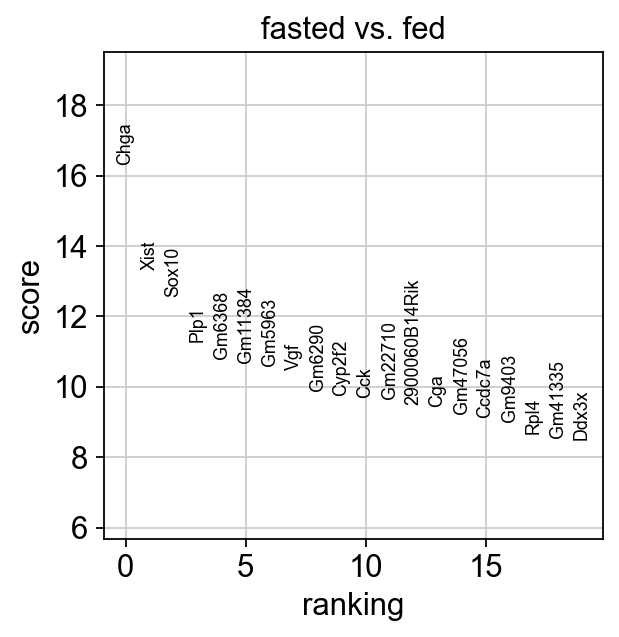

In [52]:
sc.tl.rank_genes_groups(adata, 'condition', groups=['fasted'], reference='fed', method='wilcoxon')
sc.pl.rank_genes_groups(adata, groups=['fasted'], n_genes=20,save='_tomcells_fasted.pdf')

ranking genes
    finished (0:00:02)


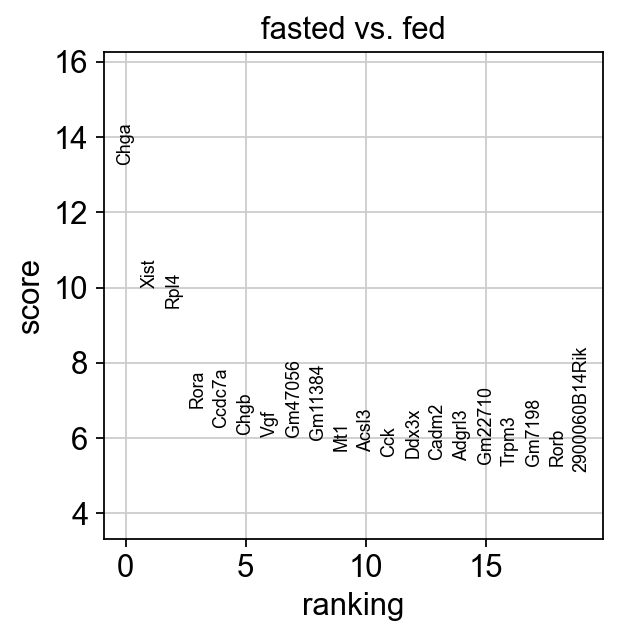

In [53]:
sc.tl.rank_genes_groups(adata_down, 'condition', groups=['fasted'], reference='fed', method='wilcoxon')
sc.pl.rank_genes_groups(adata_down, groups=['fasted'], n_genes=20,save='_tomcells_down_fasted.pdf')

If we want a more detailed view for a certain group, use `sc.pl.rank_genes_groups_violin`.

In [54]:
# check for the chromosome locations of someof the genes
adata_down.raw.var['chr']['Chga']

'12'

In [55]:
result = adata_down.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).head(5)

,fasted_n,fasted_s,fasted_l,fasted_p
0,Chga,13.271492,2.740727,1.000951e-35
1,Xist,9.986740,2.545739,2.573793e-19
2,Rpl4,9.465586,0.821754,2.875134e-17
3,Rora,6.800552,1.189533,7.698374e-08
4,Ccdc7a,6.274011,0.771424,1.732758e-06


Save the differential testing

In [56]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).to_csv(
     './write/Lepr_hypothalamus_tomcells_down_g2000e2_rank_genes_groups_fastedvsfed.csv')

Right now, I need to recalculate for fed versus fasted... Look for a more practical approach

ranking genes
    finished (0:00:03)


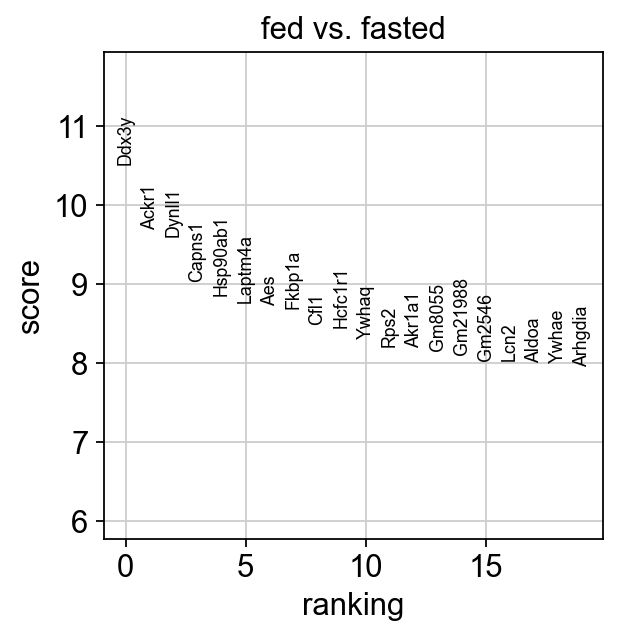

In [57]:
sc.tl.rank_genes_groups(adata, 'condition', groups=['fed'], reference='fasted', method='wilcoxon')
sc.pl.rank_genes_groups(adata, groups=['fed'], n_genes=20,save='_tomcells_fed.pdf')

ranking genes
    finished (0:00:03)


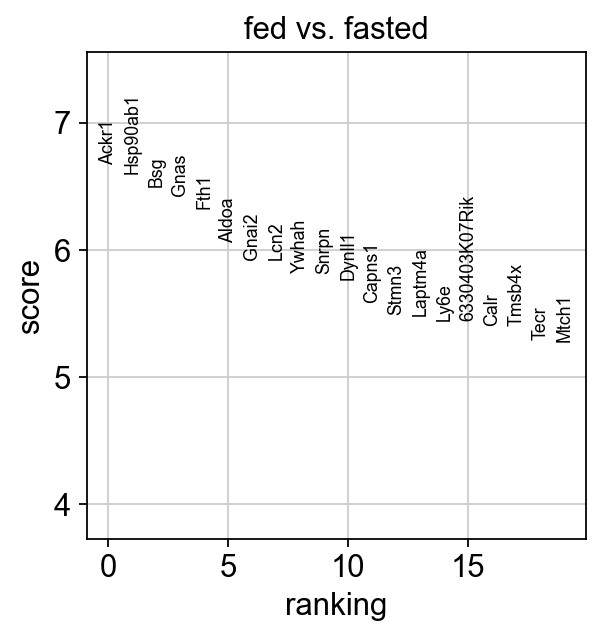

In [58]:
sc.tl.rank_genes_groups(adata_down, 'condition', groups=['fed','fasted'], reference='fasted', method='wilcoxon')
sc.pl.rank_genes_groups(adata_down, groups=['fed'], n_genes=20,save='_tomcells_down_fed.pdf')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_condition']`
categories: fasted, fed
var_group_labels: fed


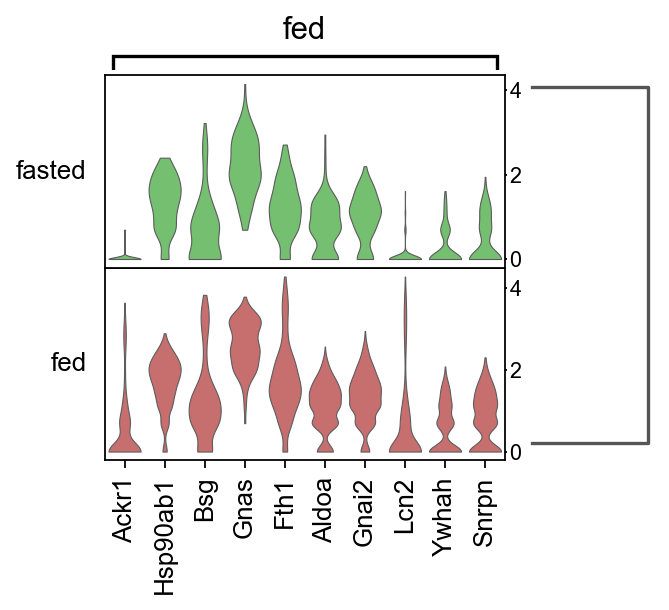

In [59]:
sc.pl.rank_genes_groups_stacked_violin(adata_down,groupby='condition')

In [60]:
result = adata_down.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).head(100)

,fed_n,fed_s,fed_l,fed_p
0,Ackr1,6.671860,4.964576,1.865757e-07
1,Hsp90ab1,6.594844,0.698560,2.515652e-07
2,Bsg,6.492089,1.245182,4.168785e-07
3,Gnas,6.422456,0.628321,4.952564e-07
4,Fth1,6.325089,0.985252,8.308865e-07
...,...,...,...,...
95,Pdxp,3.796530,1.084897,3.119140e-02
96,Atp5f1,3.775380,0.833461,3.371817e-02
97,G3bp2,3.761214,0.736744,3.543351e-02
98,Pcbp2,3.747846,0.660868,3.688245e-02


Save the differential testing

In [61]:
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores','logfoldchanges','pvals_adj']}).to_csv(
     './write/Lepr_hypothalamus_tomcells_down_g2000e2_rank_genes_groups_fedvsfasted.csv')

Save the clusters and coordinate

In [62]:
# Export single fields of the annotation of observations
adata.obs[['n_counts', 'leiden']].to_csv(
     './write/Lepr_hypothalamus_tomcells_analysis_leiden_groups.csv')
adata_down.obs[['n_counts', 'leiden']].to_csv(
     './write/Lepr_hypothalamus_tomcells_down_analysis_leiden_groups.csv')

# Export single columns of the multidimensional annotation
adata.obsm.to_df()[['X_pca1', 'X_pca2']].to_csv(
     './write/Lepr_hypothalamus_tomcells_analysis_corrected_X_pca.csv')
adata_down.obsm.to_df()[['X_pca1', 'X_pca2']].to_csv(
     './write/Lepr_hypothalamus_tomcells_down_analysis_corrected_X_pca.csv')
# Export single columns of the multidimensional annotation
adata.obsm.to_df()[['X_tsne1', 'X_tsne2']].to_csv(
     './write/Lepr_hypothalamus_tomcells_analysis_corrected_X_tsne.csv')
adata_down.obsm.to_df()[['X_tsne1', 'X_tsne2']].to_csv(
     './write/Lepr_hypothalamus_tomcells_down_analysis_corrected_X_tsne.csv')

# Or export everything except the data using `.write_csvs`.
# Set `skip_data=False` if you also want to export the data.
adata.write_csvs(results_file[:-5], )
adata_down.write_csvs(results_file_down[:-5], )


writing .csv files to ../rawdata/Lepr_hypothalamus_tomcells_analysis
writing .csv files to ../rawdata/Lepr_hypothalamus_tomcells_down_analysis


#### Plot marker genes and neuropeptide genes on UMAP and t-SNE

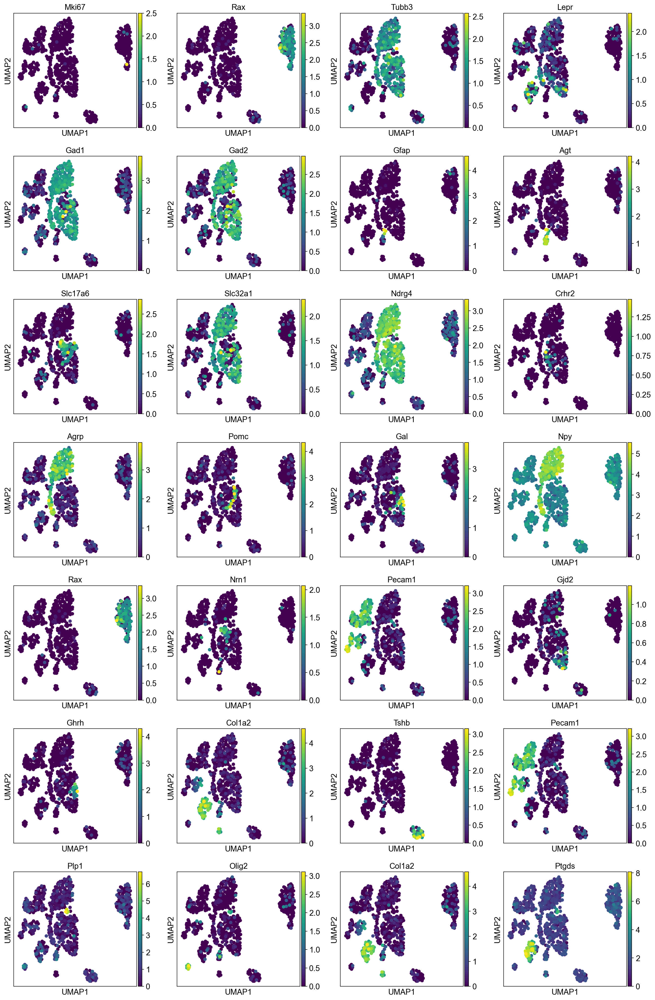

In [63]:
sc.pl.umap(adata, color= marker_genes,save='_tomcells_marker_genes_2.pdf') #, s=50

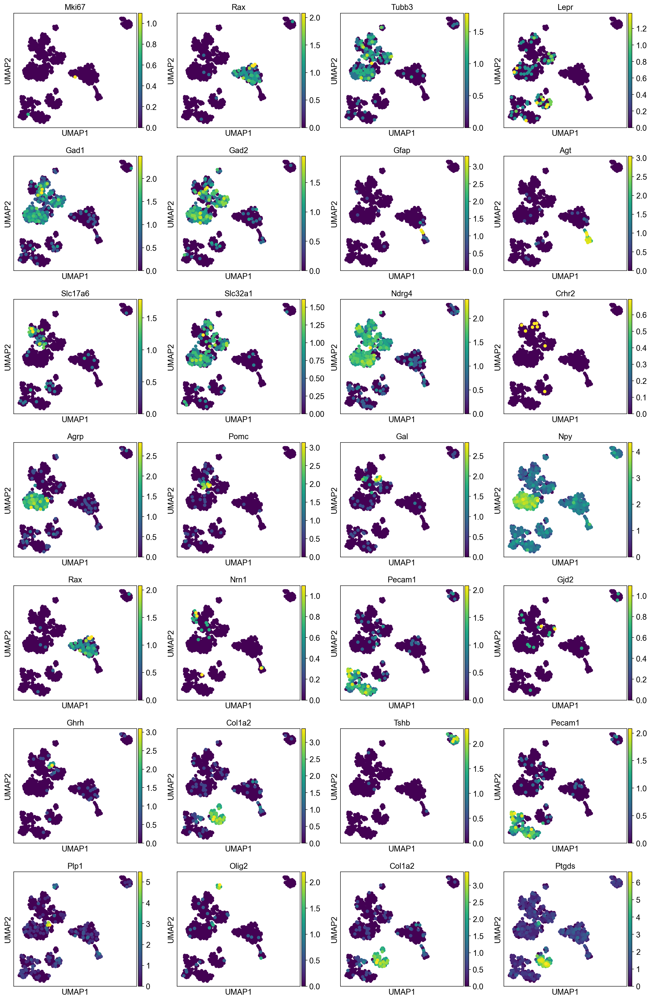

In [64]:
sc.pl.umap(adata_down, color= marker_genes,save='_tomcells_down_marker_genes_2.pdf') #, s=50

##### Neuropeptide genes from the Smith et al (eLife, 2019) 
    "Single-cell transcriptomic evidence for dense intracortical neuropeptide networks"
    After saving the plots, I stopped using these, as there is a more comprehensive list

In [65]:
neuropeptide_genes = ['Npy','Sst','Vip','Tac2','Cck','Penk','Crh','Cort',
'Tac1','Pdyn','Pthlh','Pnoc','Trh','Grp','Rln1','Adcyap1','Nts','Nmb']

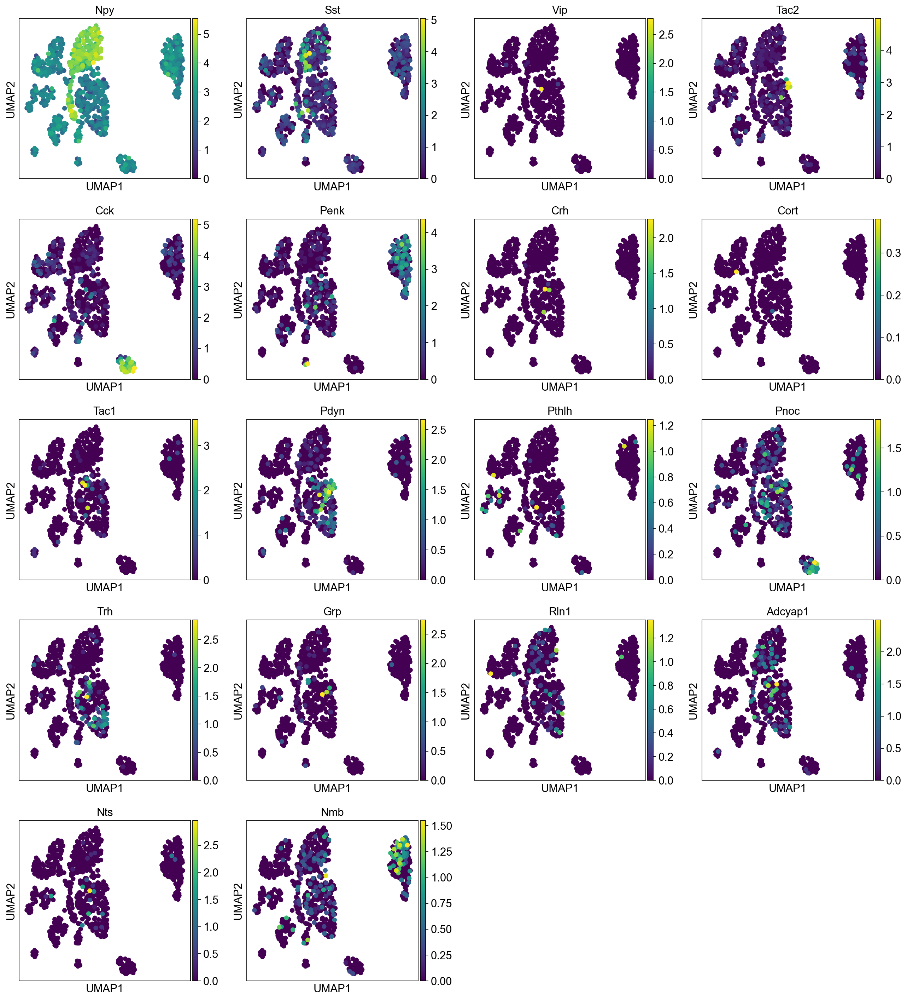

In [66]:
sc.pl.umap(adata, color= neuropeptide_genes,save='_tomcells_neuropeptide_genes.pdf')

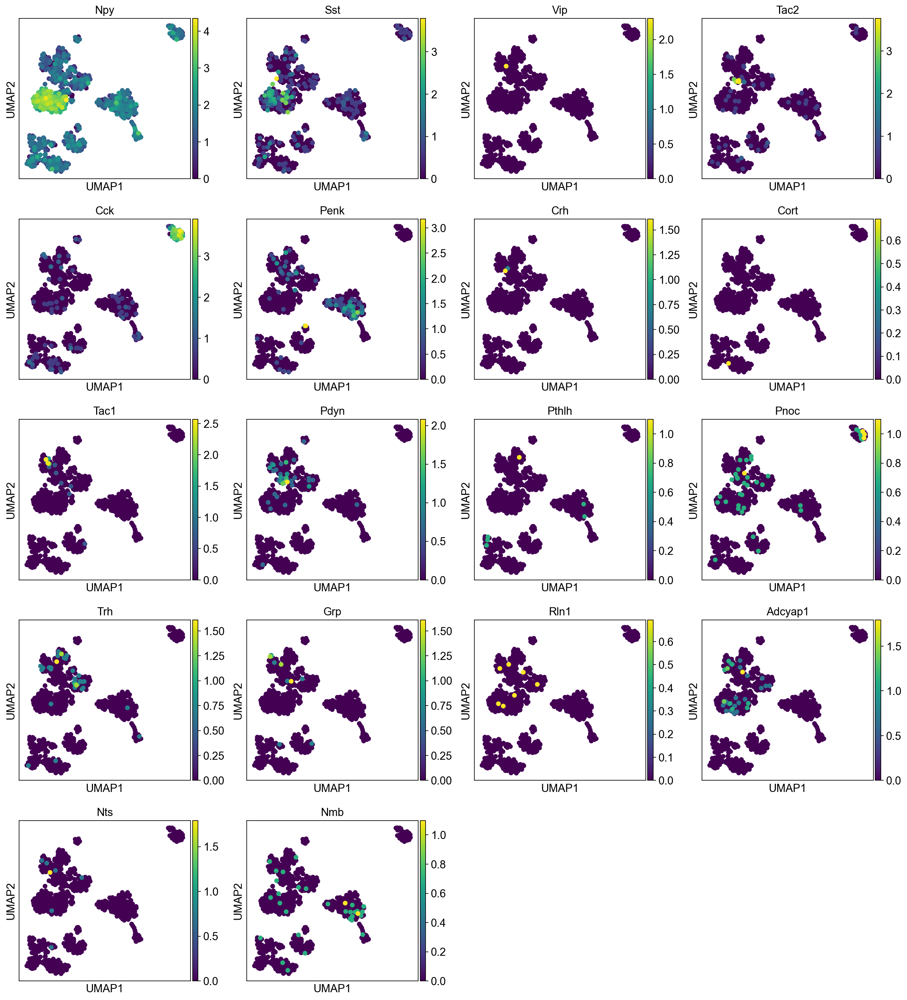

In [67]:
sc.pl.umap(adata_down, color= neuropeptide_genes,save='_tomcells_down_neuropeptide_genes.pdf')

##### The following list is more comprehensive
http://www.neuropeptides.nl/tabel%20neuropeptides%20linked.htm


In [68]:
neuropeptide_genes_all = ['Npy','Sst','Vip','Tac2','Cck','Penk','Crh','Cort',
'Tac1','Pdyn','Pthlh','Pnoc','Trh','Grp','Rln1','Adcyap1','Nts','Nmb',
'Pomc',"Avp",'Oxt','Gast','Cst','Nrrp','Rpff','Ppy','Prlh','Calca','Calcb','Iabp',"Adm",'Adm2','Nppa',
'Nppb','Nppc','Edn1','Edn2','Edn3','Sct','Cgc','Adcyap1','Ghrh','Gip','Ucn','Ucn2','Ucn3','Uts2','Uts2d',
'Tac1','Tac1','Nms','Nmu','Kng1','Nts','Chga','Chgb','Scg2','Scg3',
'Vgf','Mln','Ghrl','Gal','Galp','Gnrh1','Gnrh2','Npb',
'Npw','Nps','Nxph1','Nxph2','Nxph3','Nxph4','Ins','Igf1',
'Igf2','Rln1','Rln2','Rln3','Trh','Pthlh','Pmch','Hcrt',
'Cart','Agrp','Prl','Apln','Kiss1','Dbi','Cbln1','Cbln2','Cbln3','Cbln4',
'Lep','Adipoq','Pbef1','Retn','Retla','Retlb']
#take the overlap
neuropeptide_genes_all = np.intersect1d(adata.raw.var_names,neuropeptide_genes_all) 

In [69]:
neuropeptide_genes_all

array(['Adcyap1', 'Adm', 'Agrp', 'Apln', 'Avp', 'Calca', 'Cbln1', 'Cbln2',
       'Cbln3', 'Cbln4', 'Cck', 'Chga', 'Chgb', 'Cort', 'Crh', 'Dbi',
       'Edn1', 'Edn2', 'Edn3', 'Gal', 'Galp', 'Gast', 'Ghrh', 'Ghrl',
       'Gnrh1', 'Grp', 'Hcrt', 'Igf1', 'Igf2', 'Kiss1', 'Lep', 'Nmb',
       'Nms', 'Nmu', 'Npb', 'Nppa', 'Nppb', 'Nppc', 'Nps', 'Npw', 'Npy',
       'Nts', 'Nxph1', 'Nxph2', 'Nxph3', 'Nxph4', 'Oxt', 'Pdyn', 'Penk',
       'Pmch', 'Pnoc', 'Pomc', 'Prl', 'Prlh', 'Pthlh', 'Retn', 'Rln1',
       'Rln3', 'Scg2', 'Scg3', 'Sct', 'Sst', 'Tac1', 'Tac2', 'Trh',
       'Ucn2', 'Uts2', 'Vgf', 'Vip'], dtype=object)

## Plots to determine cell types

#### Marker gene analysis to determine cell types
    I skipped the 'shortlist' of neuropeptides
    From here on, use only downsampled dataset
    The plot below can guide cell type identification
    Try scMap by Kiselev et al, 2018 Nat Methods as well

###### Violin plot showing all neuropeptide expression by Leiden clusters

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


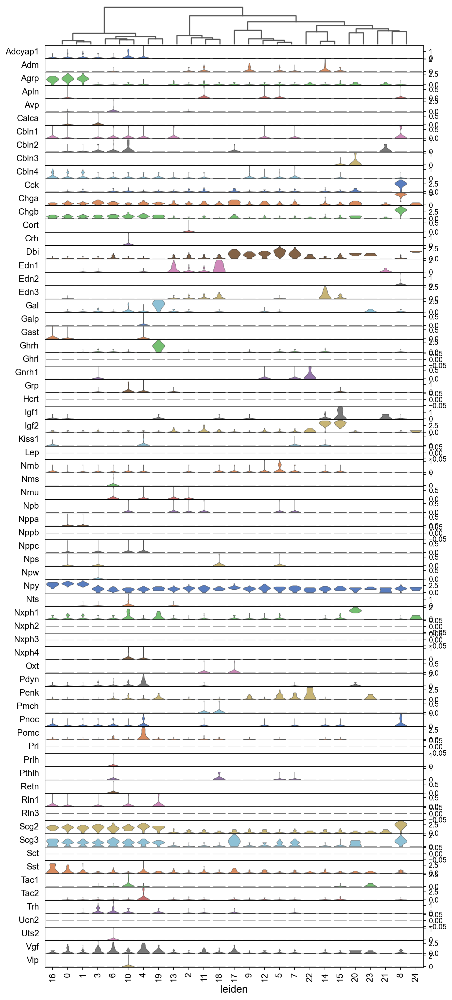

In [70]:
ax = sc.pl.stacked_violin(
    adata_down, neuropeptide_genes_all, groupby='leiden', swap_axes=True, 
     var_group_labels=['0'], dendrogram=True, 
    save='_tomcells_down_neuropeptide_genes_all.pdf')

###### Violin plot showing selected lineage marker expression by Leiden clusters

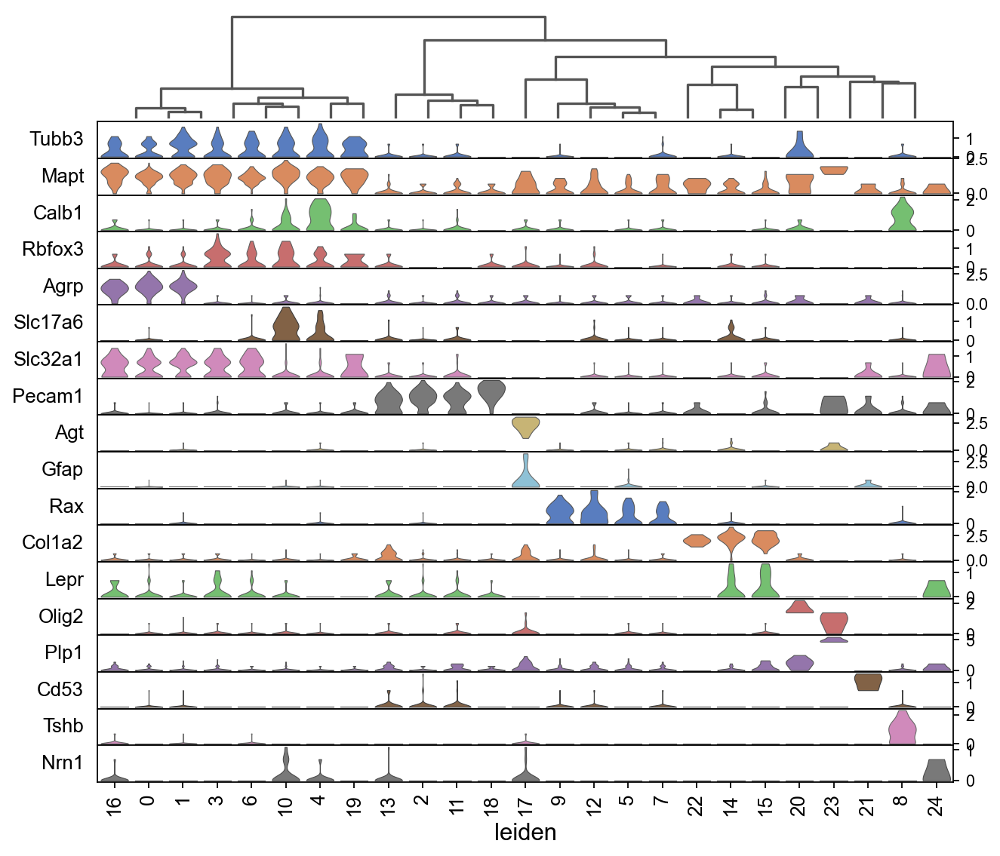

In [71]:
ax = sc.pl.stacked_violin(
    adata_down, ['Tubb3','Mapt','Calb1','Rbfox3','Agrp',"Slc17a6","Slc32a1",
                 'Pecam1','Agt','Gfap','Rax','Col1a2','Lepr','Olig2','Plp1',
                'Cd53','Tshb','Nrn1'], groupby='leiden', swap_axes=True, 
     var_group_labels=['0'], dendrogram=True, 
    save='_tomcells_down_marker_genes_mainlineage.pdf')

###### Violin plot showing marker gene expression by Leiden clusters

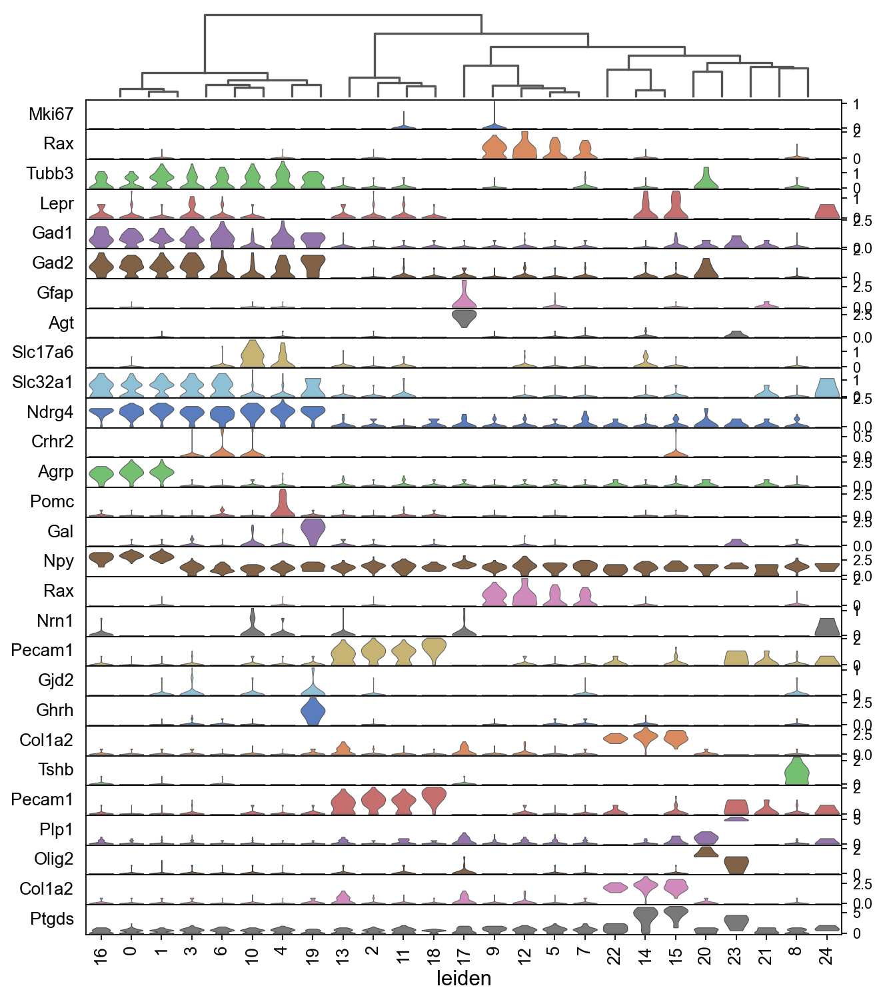

In [72]:
ax = sc.pl.stacked_violin(
    adata_down, marker_genes, groupby='leiden', swap_axes=True, 
     var_group_labels=['0'], dendrogram=True, 
    save='_tomcells_down_marker_genes.pdf')

#### Compute a hierarchical clustering for the given `groupby` categories using sc.tl.dendrogram()

In [73]:
# generate 'leiden_condition' category
adata_down.obs['leiden_condition'] = adata_down.obs['leiden'].str.cat(adata_down.obs['condition'], sep='_')

Cluster leiden groups using pca

In [74]:
sc.settings.verbosity = 1

In [75]:
sc.tl.dendrogram(adata_down,groupby='leiden',n_pcs = 40,cor_method = 'pearson',linkage_method='complete',
                key_added = 'dendogram_leiden')
# Save the plot, but dont show
sc.pl.dendrogram(adata_down,groupby='leiden',dendrogram_key='dendogram_leiden',
                 save="_tomcells_down_dendogram_leiden.pdf",show=False)

Cluster leiden groups using neuropeptide_genes_all

In [76]:
sc.tl.dendrogram(adata_down,groupby='leiden',cor_method = 'pearson',linkage_method='complete',
                var_names = neuropeptide_genes_all, key_added = 'dendogram_neuropeptide_genes_all')
# Save the plot, but dont show
sc.pl.dendrogram(adata_down,groupby='leiden',dendrogram_key = 'dendogram_neuropeptide_genes_all',
                orientation='top',save="_tomcells_down_dendogram_neuropeptide_genes_all.pdf",show=False)

... storing 'leiden_condition' as categorical


Cluster leiden_condition groups using pca

In [77]:
sc.tl.dendrogram(adata_down,groupby='leiden_condition',n_pcs = 40,cor_method = 'pearson',linkage_method='complete',
                key_added = 'dendogram_leiden_leiden_condition')
# Save the plot, but dont show
sc.pl.dendrogram(adata_down,groupby='leiden_condition',dendrogram_key = 'dendogram_leiden_leiden_condition',
                orientation='top',save="_tomcells_down_dendogram_leiden_leiden_condition.pdf",
                show=False)

Cluster leiden_condition groups using neuropeptide_genes_all

In [78]:
sc.tl.dendrogram(adata_down,groupby='leiden_condition',cor_method = 'pearson',linkage_method='complete',
                var_names = neuropeptide_genes_all, key_added = 'dendogram_neuropeptide_genes_all_leiden_condition')
# Save the plot, but dont show
sc.pl.dendrogram(adata_down,groupby='leiden_condition',
                 dendrogram_key = 'dendogram_neuropeptide_genes_all_leiden_condition',
                orientation='top',save="_tomcells_down_dendogram_neuropeptide_genes_all_leiden_condition.pdf",
                show=False)

#### Dendograms are better plotted as clustermaps, where corralation can be seen more clearly

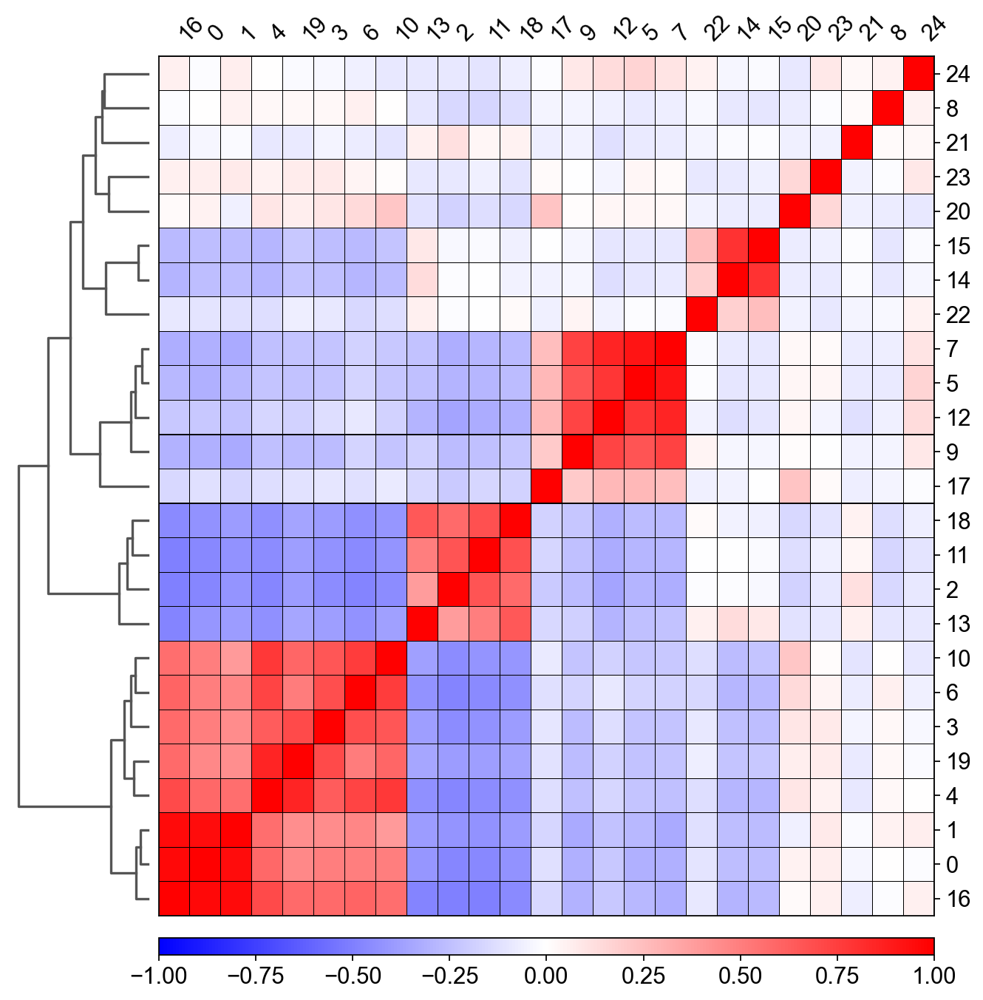

In [79]:
#Clustermap computed by sc.tl.dendogram
sc.pl.correlation_matrix(adata_down,groupby='leiden',figsize=[10,10],dendrogram ='dendogram_leiden',
                        save='_tomcells_down_dendogram_leiden.pdf')

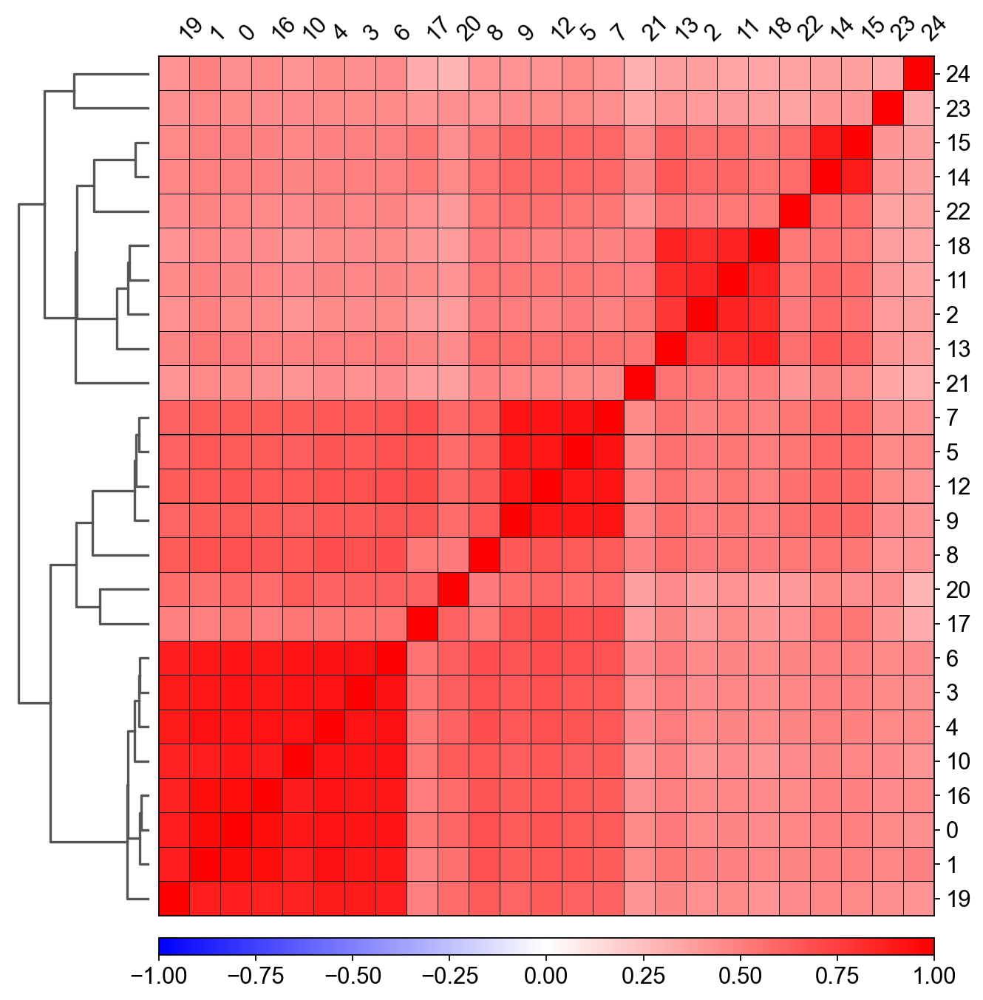

In [80]:
#Clustermap computed by sc.tl.dendogram
sc.pl.correlation_matrix(adata_down,groupby='leiden',figsize=[10,10], dendrogram = 'dendogram_neuropeptide_genes_all',
                        save='_tomcells_down_dendogram_neuropeptide_genes_all.pdf')


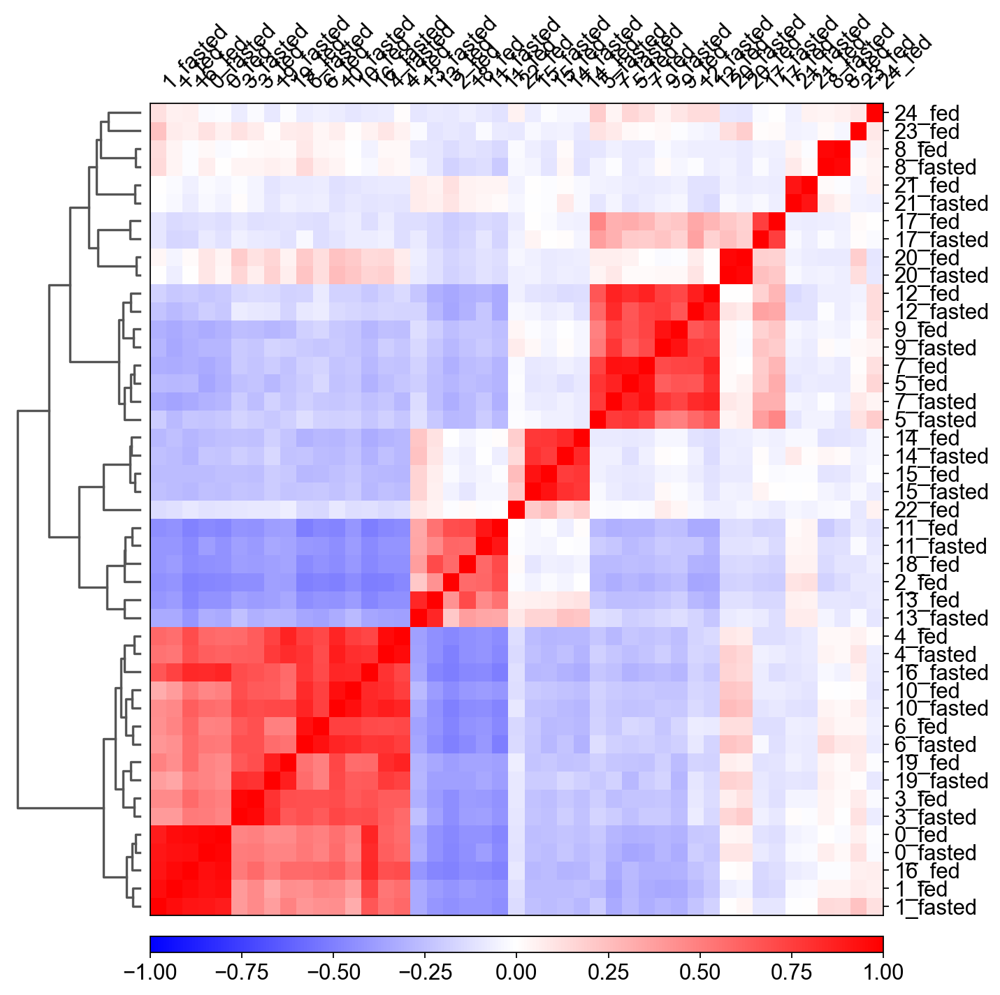

In [81]:
sc.pl.correlation_matrix(adata_down,groupby='leiden_condition',figsize=[10,10]
                         ,dendrogram ='dendogram_leiden_leiden_condition',
                        save='_tomcells_down_dendogram_leiden_leiden_condition.pdf')

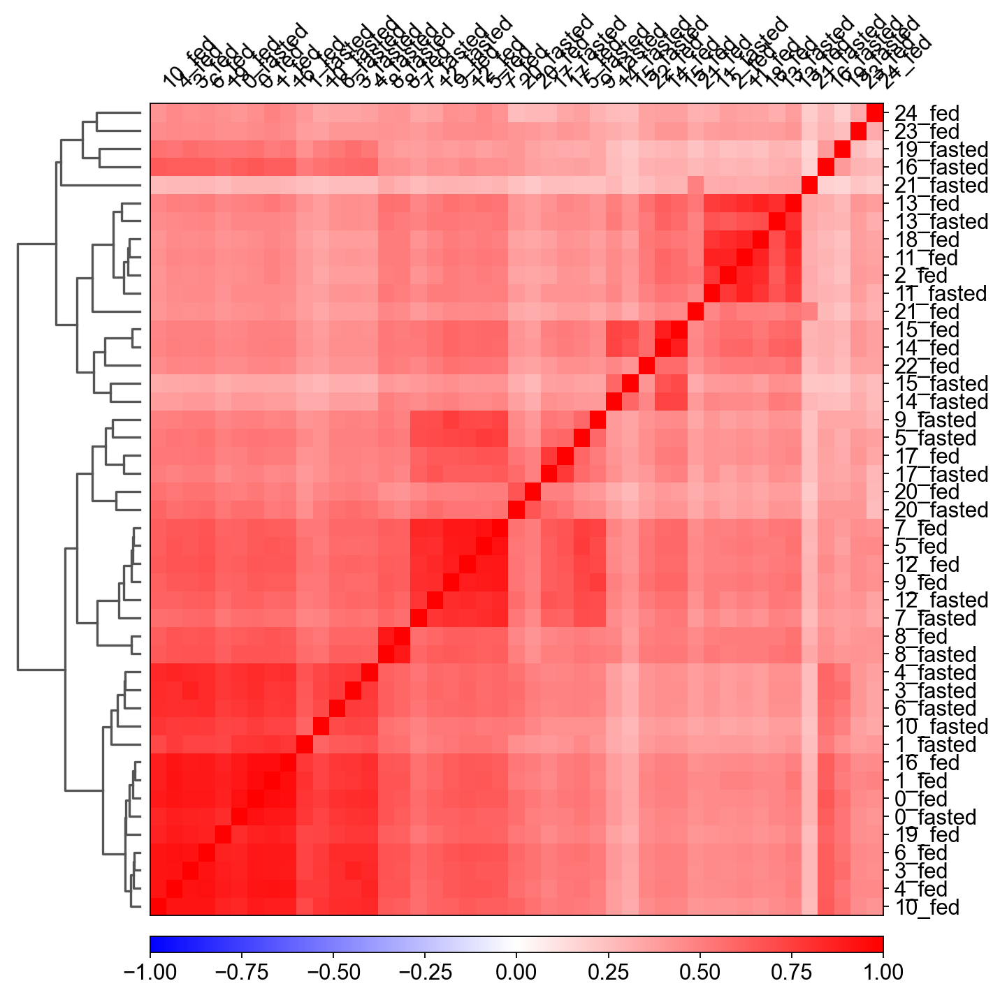

In [82]:
sc.pl.correlation_matrix(adata_down,groupby='leiden_condition',figsize=[10,10]
                         ,dendrogram ='dendogram_neuropeptide_genes_all_leiden_condition',
                        save='_tomcells_down_dendogram_neuropeptide_genes_all_leiden_condition.pdf')

###### Tracksplot
It is better to use non-log valus for this one. We will do this using hte following code:

The following is necessary only if the last ranking is different e.g. fed versus fasting

In [83]:
sc.tl.rank_genes_groups(adata_down, 'leiden', method='wilcoxon')

In [84]:
ad_down = adata_down.copy()  # track plot data is better visualized using the non-log counts
ad_down.raw.X.data = np.expm1(ad_down.raw.X.data)

/Users/onurbasak/miniconda3/envs/sc/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Assigning the 'data' attribute is an inherently unsafe operation and will be removed in the future.
  


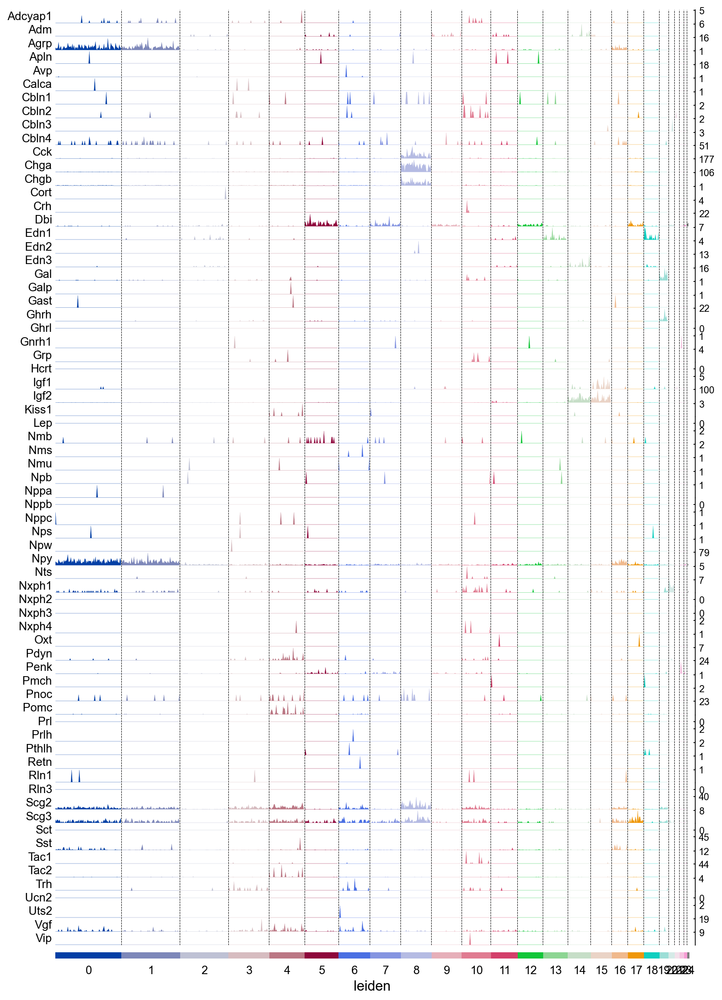

In [85]:
ax = sc.pl.tracksplot(ad_down,neuropeptide_genes_all, groupby='leiden', save = "_tomcells_down_neuropeptide_genes_all.pdf")

#### Plot the cluster numbers

Without annotation

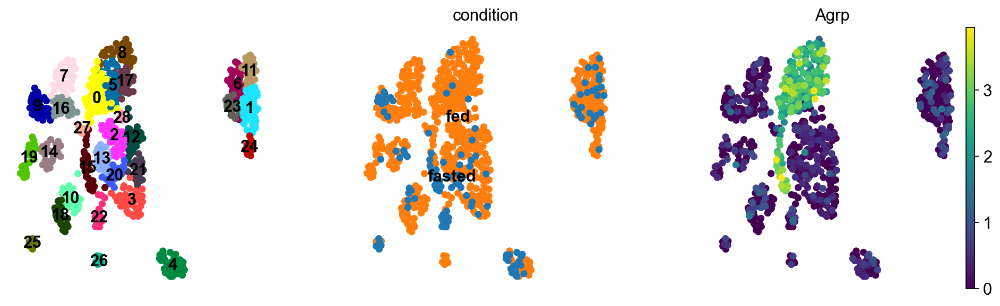

In [86]:
sc.pl.umap(adata, color=['leiden','condition','Agrp'], legend_loc='on data', title='', frameon=False, save='_tomcells_on_data.pdf')

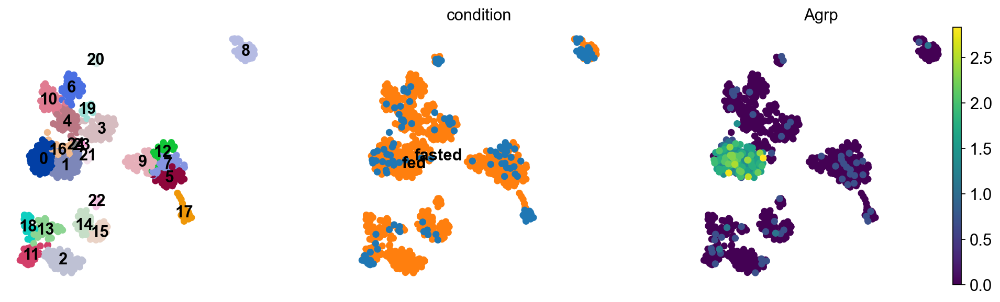

In [87]:
sc.pl.umap(adata_down, color=['leiden','condition','Agrp'], legend_loc='on data', title='', frameon=False, save='_tomcells_down_on_data.pdf')

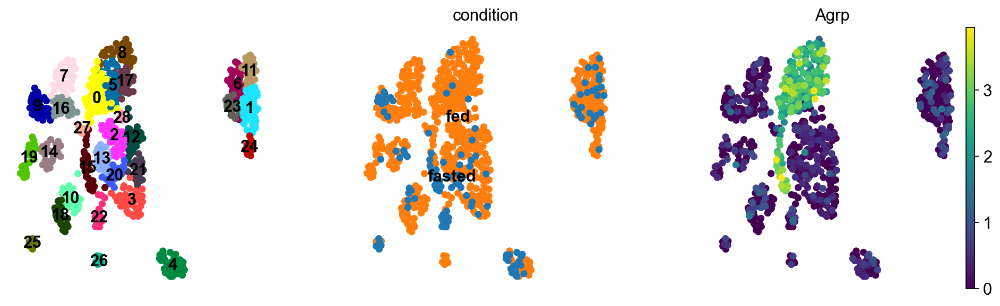

In [88]:
sc.pl.umap(adata, color=['leiden','condition','Agrp'], legend_loc='on data', title='', frameon=False, save='_tomcells_on_data.pdf')

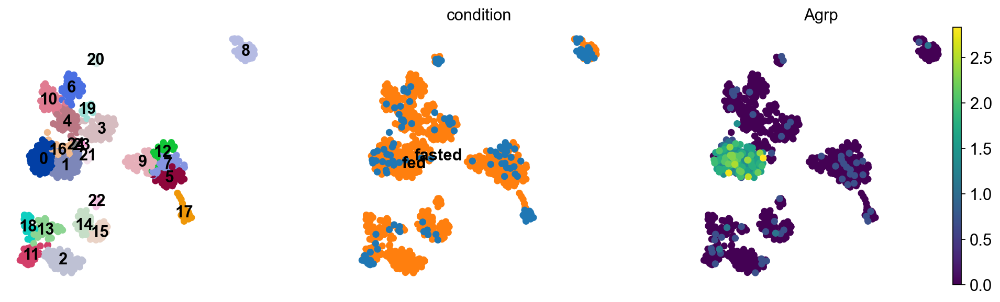

In [89]:
sc.pl.umap(adata_down, color=['leiden','condition','Agrp'], legend_loc='on data', title='', frameon=False, save='_tomcells_down_on_data.pdf')

In [90]:
# save the cluster numbers
adata_down.obs['leiden_cluster_numbers'] = adata_down.obs['leiden']
adata_down.obs['cell_types'] = adata_down.obs['leiden']

In [91]:
new_cluster_names = ['0', '1', '2', '3', 
                     '4', '5','6','7', 
                     '8','9','10','11',
                     '12','13', '14','15',
                     '16','17','18','19',
                     '20','21','22','23',
                     '24']
adata_down.rename_categories('cell_types', new_cluster_names)

Save

In [92]:
adata.write(results_file)
adata_down.write(results_file_down)

## Visualise the differences between clusters

Now that we annotated the cell types, let us visualize the marker genes.

There is also a very compact violin plot.

In [122]:
import scanpy.external as sce
import pandas as pd
from matplotlib import rcParams
sc.logging.print_versions()

scanpy==1.5.1 anndata==0.7.1 umap==0.4.4 numpy==1.18.4 scipy==1.4.1 pandas==1.0.3 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 louvain==0.7.0 leidenalg==0.8.0


In [94]:
#Reload the data if starting from here
adata_down = sc.read(results_file_down) #'../rawdata/Lepr_hypothalamus_tomcells_down_analysis.h5ad'


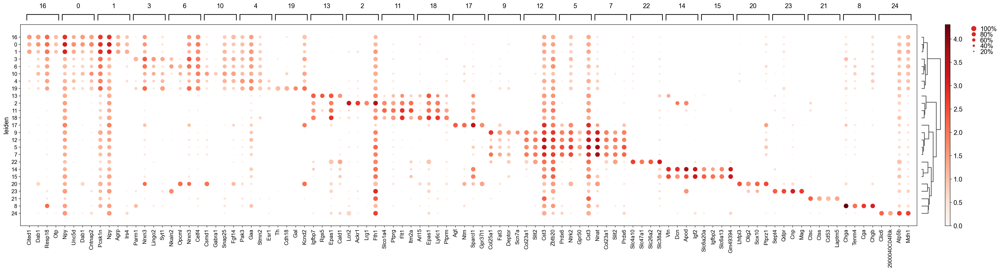

In [95]:
sc.pl.rank_genes_groups_dotplot(adata_down, n_genes=4,save = "_tomcells_down_leiden_rankgenes.pdf")

In [96]:
# If you want to plot specific groups
#axs = sc.pl.rank_genes_groups_dotplot(adata_down, n_genes=5,
#                                      save = "_tomcells_down_leiden_rankgenes.pdf") #, groups=['0', '1','2','3','4','5']

###### matrix plot rank genes per cluster

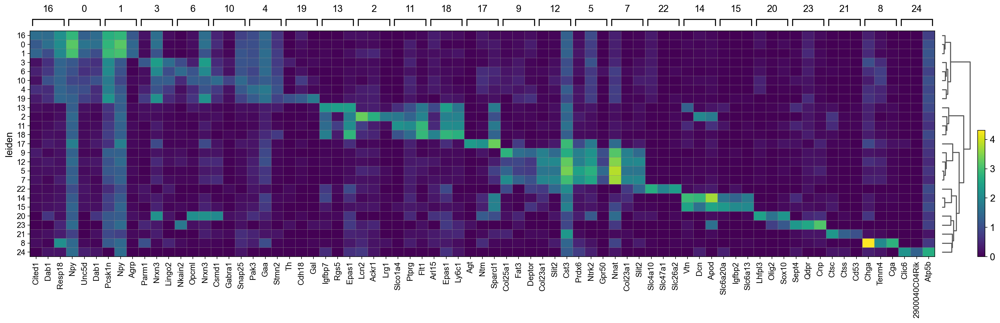

In [97]:
axs = sc.pl.rank_genes_groups_matrixplot(adata_down, n_genes=3, use_raw=True,
                                         save = "_tomcells_down_leiden_rankgenes.pdf")

###### Violin plots rank genes per cluster

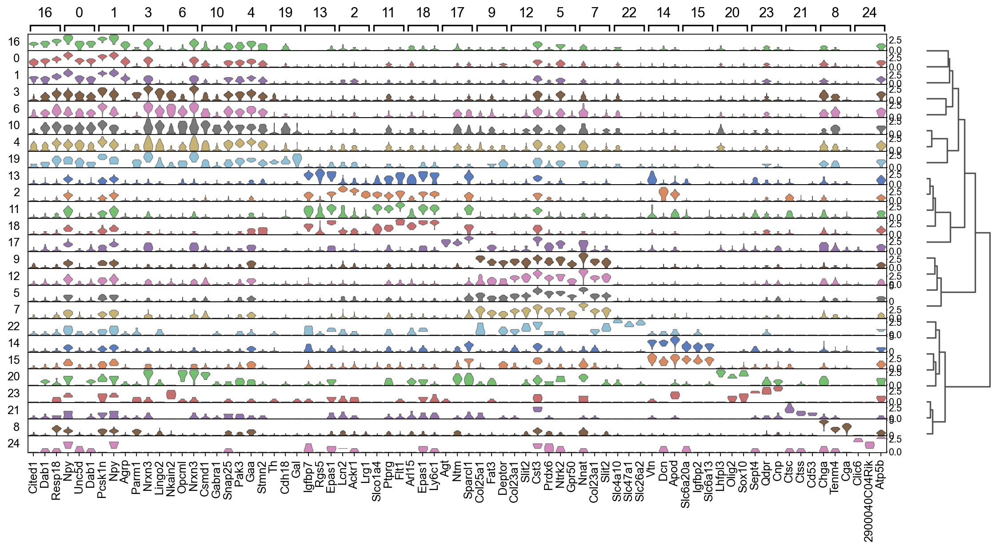

In [98]:
sc.pl.rank_genes_groups_stacked_violin(adata_down, n_genes=3
                                       ,save = "_tomcells_down_leiden_rankgenes.pdf") # row_palette='slateblue'

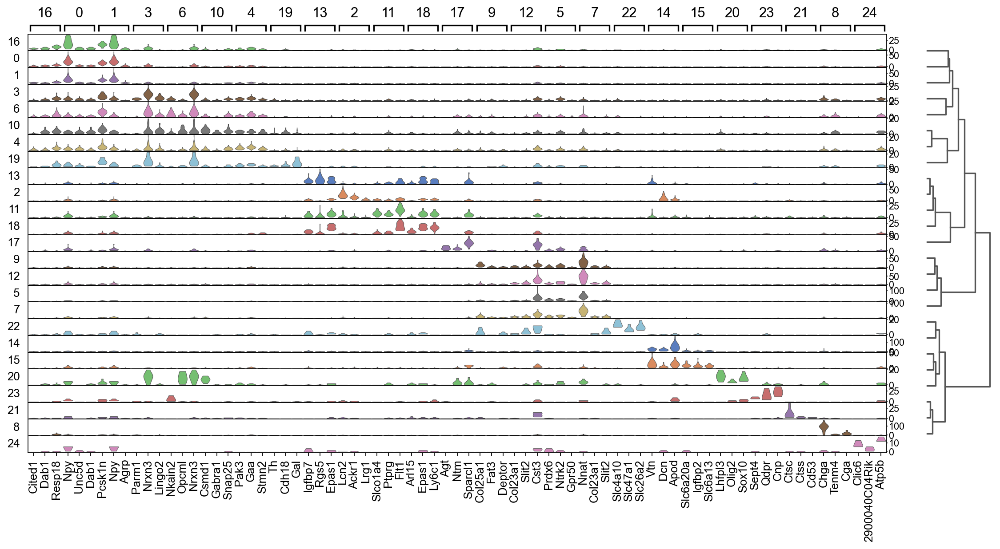

In [99]:
# instead of adata_down we use the 'ad_down' object (created earlier) in which the raw matrix is exp(pbmc.raw.matrix). This
# highlights the differences between the markers.
sc.pl.rank_genes_groups_stacked_violin(ad_down, n_genes=3
                                       ,save = "_tomcells_down_leiden_rankgenes_raw.pdf") # row_palette='slateblue'

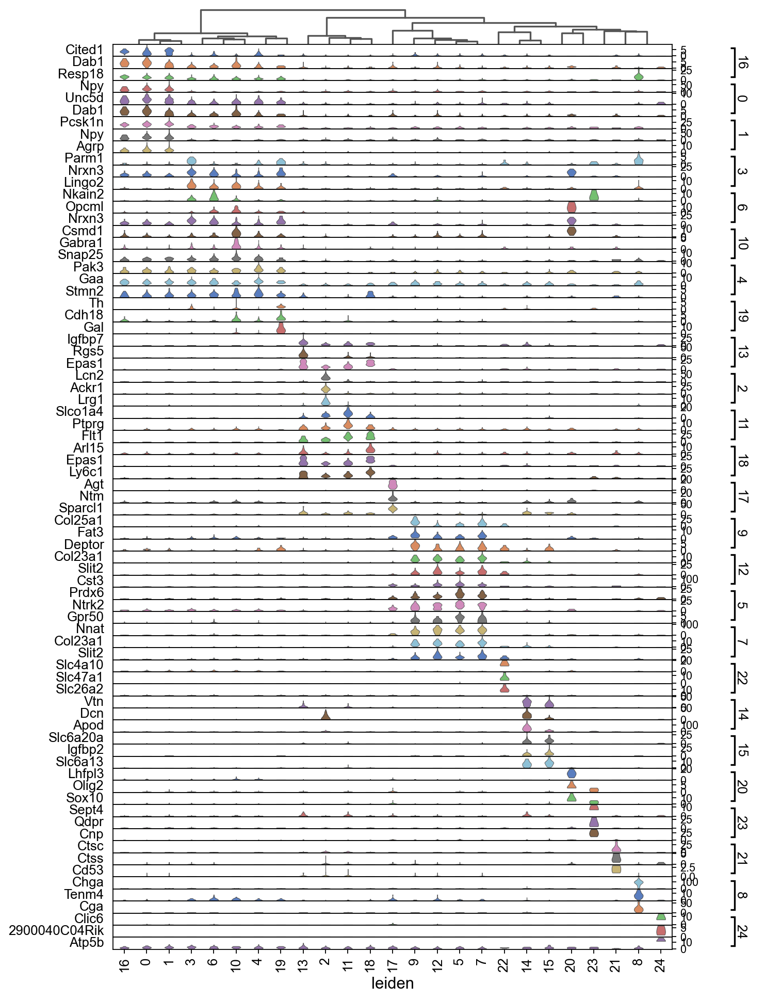

In [100]:
# width is used to set the violin plot width. Here, after setting figsize wider than default,
# the `width` arguments helps to keep the violin plots thin.
sc.pl.rank_genes_groups_stacked_violin(ad_down, n_genes=3, swap_axes=True, figsize=(10, 15), width=0.4,
                                      save = "_tomcells_down_leiden_rankgenes_raw_swap.pdf")

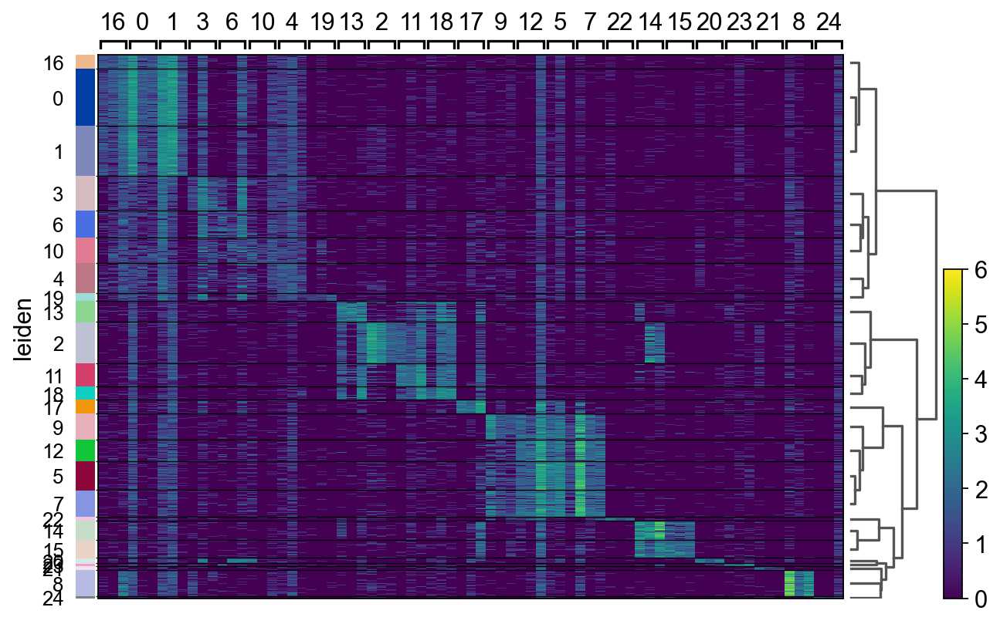

In [101]:
sc.pl.rank_genes_groups_heatmap(adata_down, n_genes=3, vmax=6,
                                save = "_tomcells_down_leiden_rankgenes.pdf")

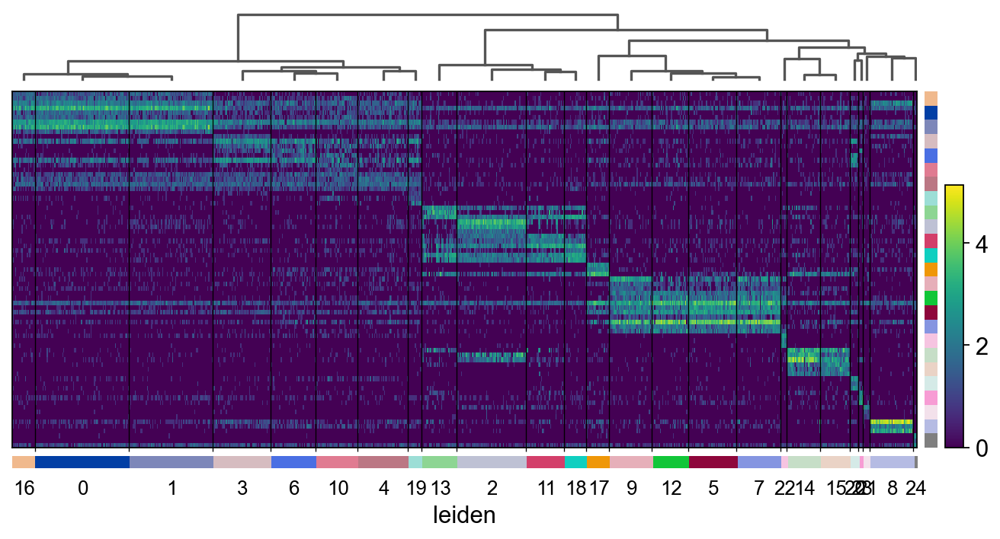

In [102]:
sc.pl.rank_genes_groups_heatmap(adata_down, n_genes=3, use_raw=True, swap_axes=True,
                                save = "_tomcells_down_leiden_rankgenes_swap.pdf")

Compare CD4+/CD25 T Reg markers vs. rest using violin.

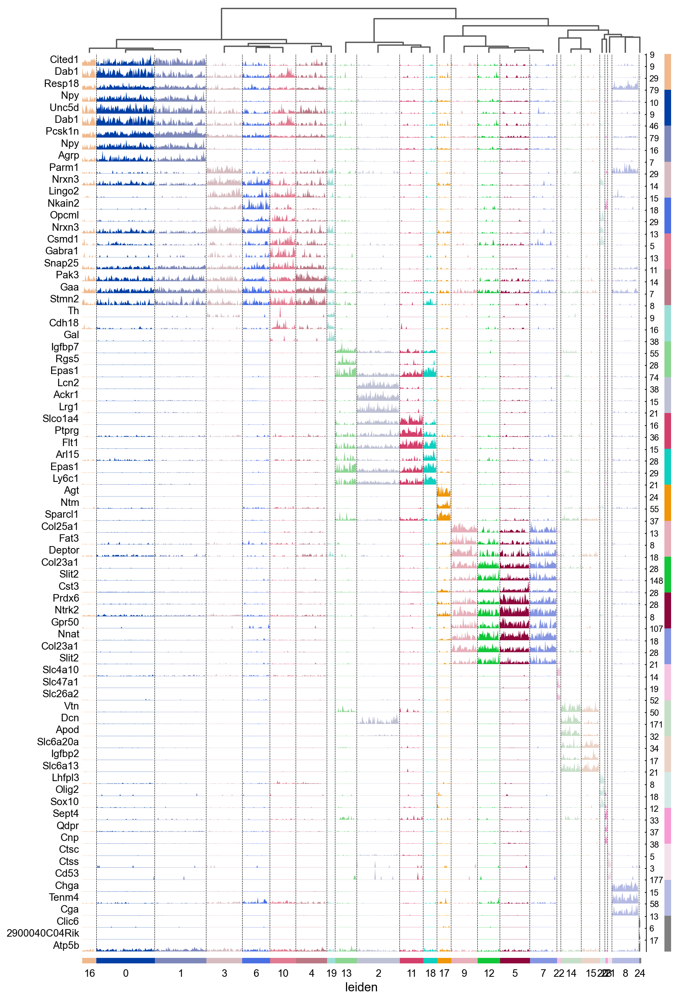

In [103]:
sc.pl.rank_genes_groups_tracksplot(ad_down, n_genes=3,
                                save = "_tomcells_down_leiden_rankgenes.pdf")

# Assign cell types and conditions

## Assign cell types


In [105]:
cell_types = ["Agrp_neurons_1","Agrp_neurons_2","endothelial_1","Crhr2_Npw_neurons","Pomc_neurons","Tanycytes_1",
"Crhr2_Prlh_neurons","Tanycytes_2","Pitituary","Tanycytes_3","Crhr2_Crh_neurons","endothelial_3",
"Tanycytes_4","endothelial_2","Vlmcs_Igf2_Edn3","Vlmcs_Igf2_Igf1",
"Agrp_neurons_3","Astrocytes","endothelial_4","Ghrh_neurons",
"OPCs","Microglia","Vlmcs_penk_Gnrh2","oligodendrocytes",
"Nrn1_non_neuronal"]



In [106]:
adata_down.obs['cell_types'] = adata_down.obs['leiden']
adata_down.rename_categories('cell_types', cell_types)
adata_down.obs['cell_types']

tom_P1_fed_2              Pomc_neurons
tom_P1_fed_3          oligodendrocytes
tom_P1_fed_5                Astrocytes
tom_P1_fed_7              Ghrh_neurons
tom_P1_fed_8               Tanycytes_1
                           ...        
tom_P5_fasted_241    Crhr2_Crh_neurons
tom_P5_fasted_242            Pitituary
tom_P5_fasted_243        endothelial_3
tom_P5_fasted_244          Tanycytes_4
tom_P5_fasted_247          Tanycytes_2
Name: cell_types, Length: 824, dtype: category
Categories (25, object): [Agrp_neurons_1, Agrp_neurons_2, endothelial_1, Crhr2_Npw_neurons, ..., Microglia, Vlmcs_penk_Gnrh2, oligodendrocytes, Nrn1_non_neuronal]

copy the cell_types into adata

In [107]:
adata.obs['cell_types'] = adata_down.obs['cell_types']

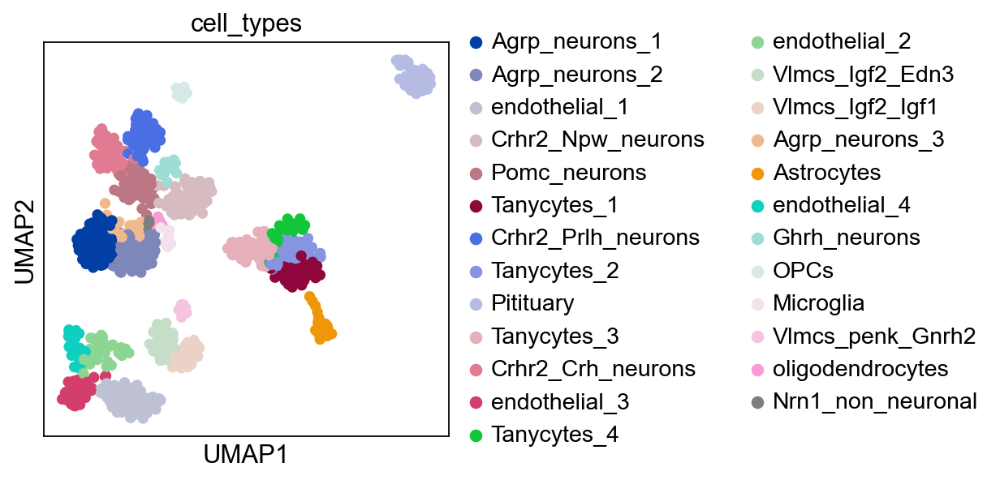

In [108]:
sc.pl.umap(adata_down, color=['cell_types'], use_raw=True,save="_tomcells_down_celltypes.pdf")

Some info on the number of cells for different conditions

In [109]:
adata_down[adata_down.obs['cell_types'].isin(["Pitituary"])] #40 Pitituary cells are excluded
adata_down[adata_down.obs['condition'].isin(["fasted"])] #132
adata_down[adata_down.obs['condition'].isin(["fed"])] #692

View of AnnData object with n_obs × n_vars = 692 × 1980
    obs: 'ERCC_genes', 'n_counts_withERCCmito', 'n_genes', 'n_counts_with_mito', 'percent_mito', 'n_counts', 'percent_ribo', 'percent_coding', 'percent_lincRNA', 'sum_lincRNA', 'percent_antisense', 'sum_antisense', 'percent_miRNA', 'sum_miRNA', 'percent_bidirectional_promoter_lncRNA', 'sum_bidirectional_promoter_lncRNA', 'percent_snoRNA', 'type', 'plate', 'condition', 'chrY_counts', 'chrX_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'normalisation_factor', 'n_counts_down', 'leiden', 'leiden_condition', 'leiden_cluster_numbers', 'cell_types'
    var: 'fullname', 'ENS_names', 'geneid', 'feature', 'chr', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'di

## Assign cell clusters

Rename the categories to group neurons into broader categories (Move this to another notebook)

In [110]:
adata_down.obs['cell_categories'] = adata.obs['cell_categories'] = adata_down.obs['cell_types']

In [111]:
# Write down the list of cell_types
cell_types = ["Agrp_neurons_1","Agrp_neurons_2","endothelial_1","Crhr2_Npw_neurons","Pomc_neurons","Tanycytes_1",
"Crhr2_Prlh_neurons","Tanycytes_2","Pitituary","Tanycytes_3","Crhr2_Crh_neurons","endothelial_3",
"Tanycytes_4","endothelial_2","Vlmcs_Igf2_Edn3","Vlmcs_Igf2_Igf1",
"Agrp_neurons_3","Astrocytes","endothelial_4","Ghrh_neurons",
"OPCs","Microglia","Vlmcs_penk_Gnrh2","oligodendrocytes",
"Nrn1_non_neuronal"]

# Write down what to replace them with
cell_categories = ["Agrp_neurons","Agrp_neurons","endothelial","Crhr2","Pomc_neurons","Tanycytes",
"Crhr2","Tanycytes","Pitituary","Tanycytes","Crhr2","endothelial",
"Tanycytes","endothelial","Vlmcs","Vlmcs",
"Agrp_neurons","Astrocytes","endothelial","Ghrh_neurons",
"OPCs","Microglia","Vlmcs","oligodendrocytes",
"Nrn1_non_neuronal"]
#cell_categories

rename the categories

In [112]:
adata.obs['cell_categories'] = \
    adata.obs['cell_categories'].astype('object').replace(cell_types,cell_categories).astype('category')
adata_down.obs['cell_categories'] = adata.obs['cell_categories']
adata.obs['cell_categories']


tom_P1_fed_2             Pomc_neurons
tom_P1_fed_3         oligodendrocytes
tom_P1_fed_5               Astrocytes
tom_P1_fed_7             Ghrh_neurons
tom_P1_fed_8                Tanycytes
                           ...       
tom_P5_fasted_241               Crhr2
tom_P5_fasted_242           Pitituary
tom_P5_fasted_243         endothelial
tom_P5_fasted_244           Tanycytes
tom_P5_fasted_247           Tanycytes
Name: cell_categories, Length: 824, dtype: category
Categories (13, object): [Agrp_neurons, Astrocytes, Crhr2, Ghrh_neurons, ..., Tanycytes, Vlmcs, endothelial, oligodendrocytes]

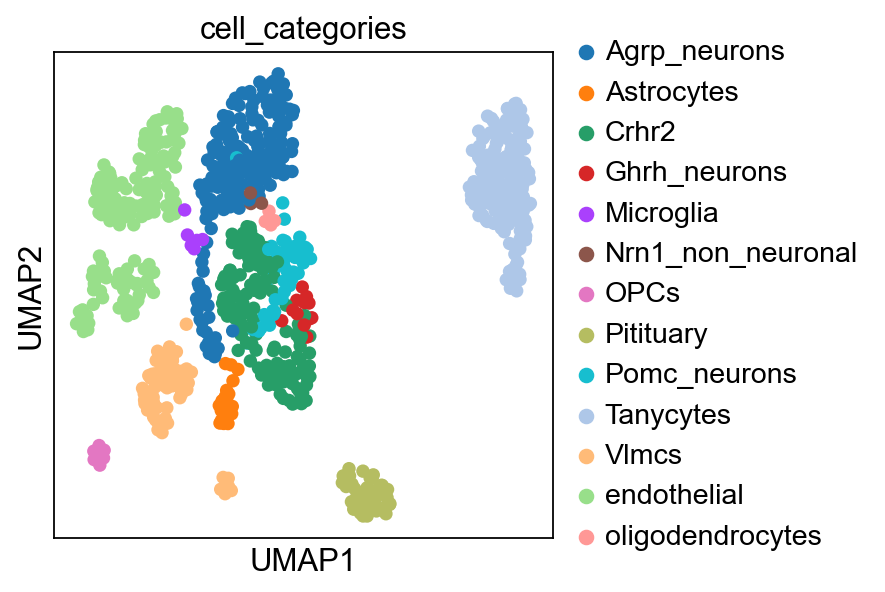

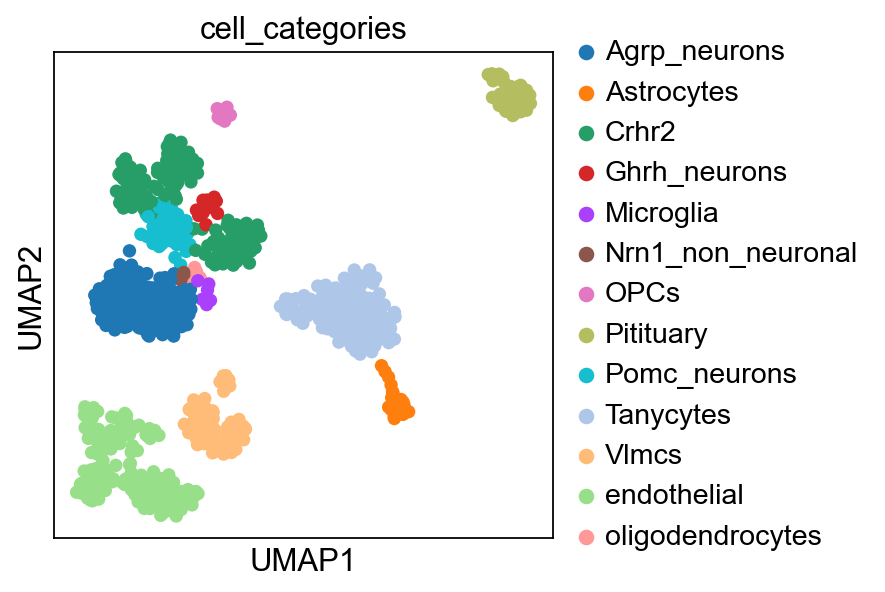

In [113]:
sc.pl.umap(adata, color=['cell_categories'], use_raw=True,save="_tomcells_cellcat.pdf")
sc.pl.umap(adata_down, color=['cell_categories'], use_raw=True,save="_tomcells_down_cellcat.pdf")

### assign cell type categories

In [114]:
adata.obs['cell_types_condition'] = adata_down.obs['cell_types_condition'] = \
adata_down.obs['cell_types'].str.cat(adata_down.obs['condition'], sep='_').astype('category')

In [115]:
adata.obs['cell_categories_condition'] = adata_down.obs['cell_categories_condition'] = \
adata_down.obs['cell_categories'].str.cat(adata_down.obs['condition'], sep='_').astype('category')

## Save

###### save the dataset

In [116]:
adata.write(results_file)
adata_down.write(results_file_down)

move the following elsewhere

## Plot the clustermaps with cell types as labels
as opposed to Leiden cluster numbers before

In [117]:
adata_down.obs['cell_types_condition']

tom_P1_fed_2                 Pomc_neurons_fed
tom_P1_fed_3             oligodendrocytes_fed
tom_P1_fed_5                   Astrocytes_fed
tom_P1_fed_7                 Ghrh_neurons_fed
tom_P1_fed_8                  Tanycytes_1_fed
                               ...           
tom_P5_fasted_241    Crhr2_Crh_neurons_fasted
tom_P5_fasted_242            Pitituary_fasted
tom_P5_fasted_243        endothelial_3_fasted
tom_P5_fasted_244          Tanycytes_4_fasted
tom_P5_fasted_247          Tanycytes_2_fasted
Name: cell_types_condition, Length: 824, dtype: category
Categories (45, object): [Agrp_neurons_1_fasted, Agrp_neurons_1_fed, Agrp_neurons_2_fasted, Agrp_neurons_2_fed, ..., endothelial_3_fasted, endothelial_3_fed, endothelial_4_fed, oligodendrocytes_fed]

##### The following list is more comprehensive
http://www.neuropeptides.nl/tabel%20neuropeptides%20linked.htm

In [118]:
neuropeptide_genes_all = ['Npy','Sst','Vip','Tac2','Cck','Penk','Crh','Cort',
'Tac1','Pdyn','Pthlh','Pnoc','Trh','Grp','Rln1','Adcyap1','Nts','Nmb',
'Pomc',"Avp",'Oxt','Gast','Cst','Nrrp','Rpff','Ppy','Prlh','Calca','Calcb','Iabp',"Adm",'Adm2','Nppa',
'Nppb','Nppc','Edn1','Edn2','Edn3','Sct','Cgc','Adcyap1','Ghrh','Gip','Ucn','Ucn2','Ucn3','Uts2','Uts2d',
'Tac1','Tac1','Nms','Nmu','Kng1','Nts','Chga','Chgb','Scg2','Scg3',
'Vgf','Mln','Ghrl','Gal','Galp','Gnrh1','Gnrh2','Npb',
'Npw','Nps','Nxph1','Nxph2','Nxph3','Nxph4','Ins','Igf1',
'Igf2','Rln1','Rln2','Rln3','Trh','Pthlh','Pmch','Hcrt',
'Cart','Agrp','Prl','Apln','Kiss1','Dbi','Cbln1','Cbln2','Cbln3','Cbln4',
'Lep','Adipoq','Pbef1','Retn','Retla','Retlb']
#take the overlap
neuropeptide_genes_all = np.intersect1d(adata_down.raw.var_names,neuropeptide_genes_all) 

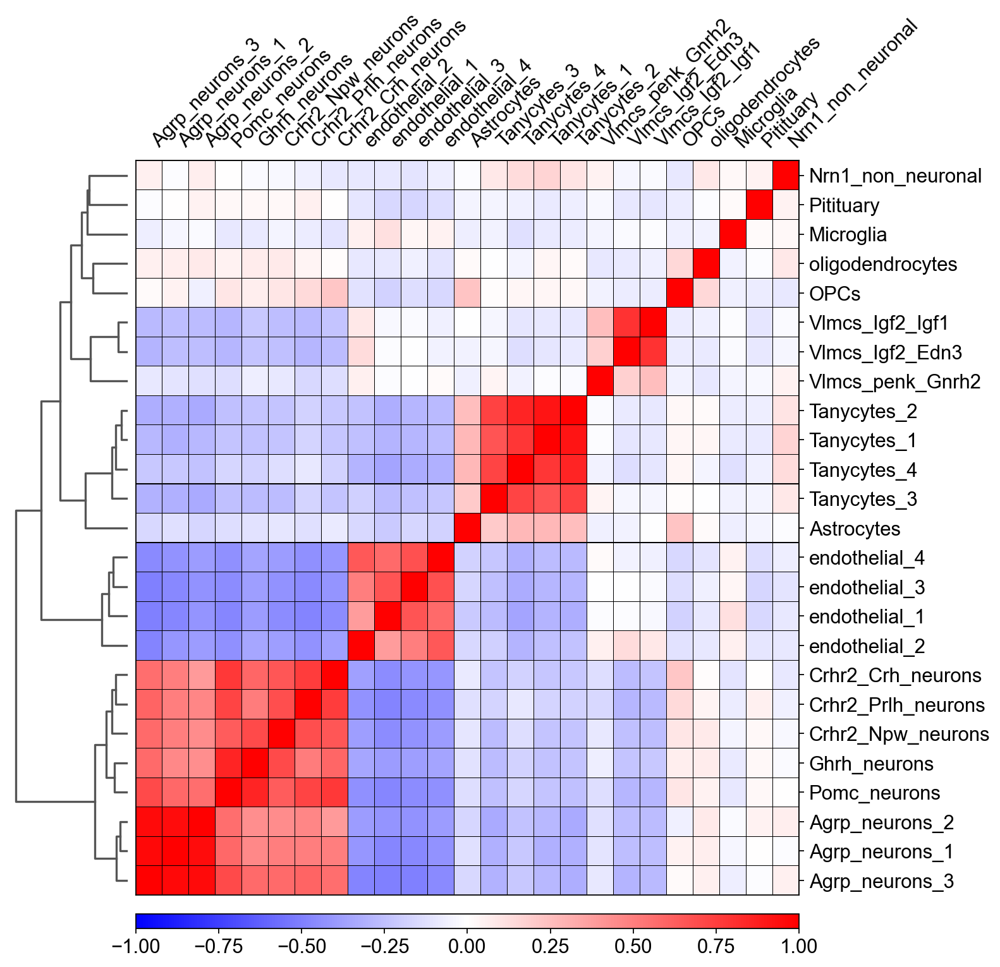

In [124]:
#Clustermap computed by sc.tl.dendogram
sc.pl.correlation_matrix(adata_down,groupby='cell_types',figsize=[10,10],dendrogram ='dendogram_leiden',
                        save='_tomcells_down_celltypes_dendogram_leiden.pdf')


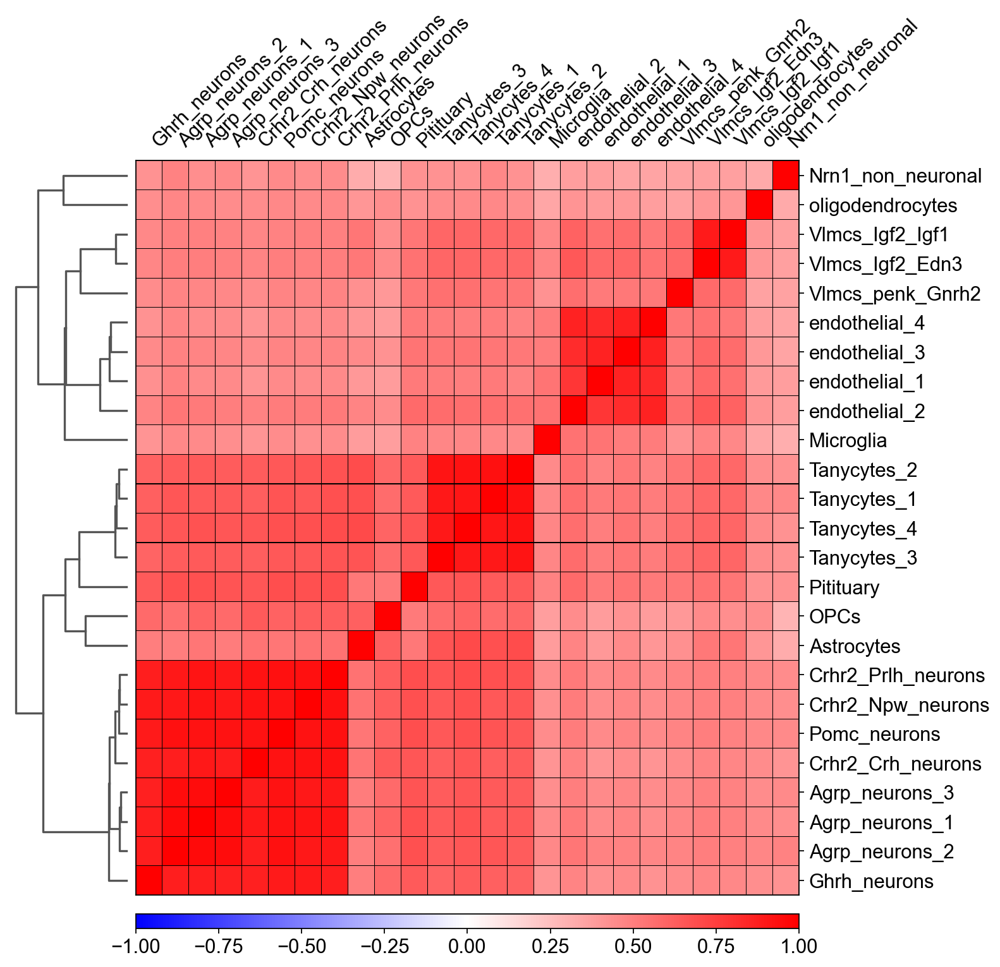

In [125]:
#Clustermap computed by sc.tl.dendogram
sc.pl.correlation_matrix(adata_down,groupby='cell_types',figsize=[10,10], dendrogram = 'dendogram_neuropeptide_genes_all',
                        save='_tomcells_down_celltypes_dendogram_neuropeptide_genes_all.pdf')


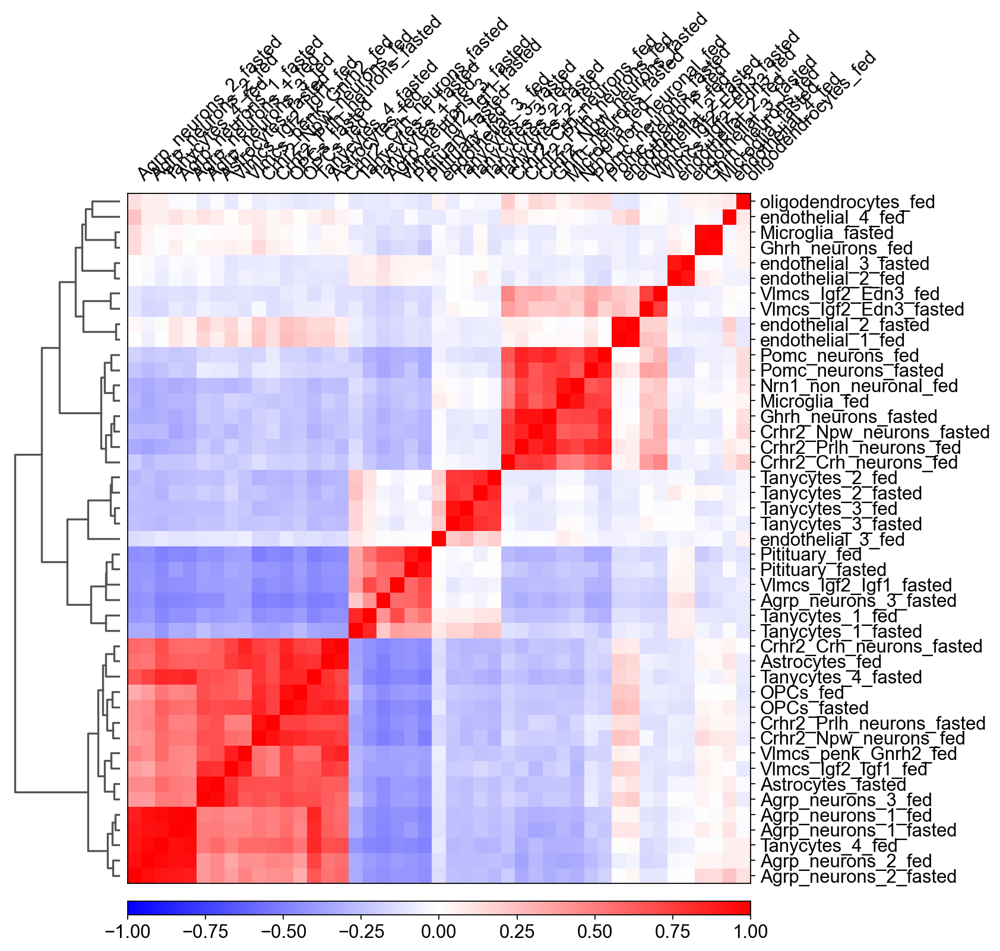

In [126]:
sc.pl.correlation_matrix(adata_down,groupby='cell_types_condition',figsize=[10,10]
                         ,dendrogram ='dendogram_leiden_leiden_condition',
                        save='_tomcells_down_celltypes_dendogram_leiden_leiden_condition.pdf')

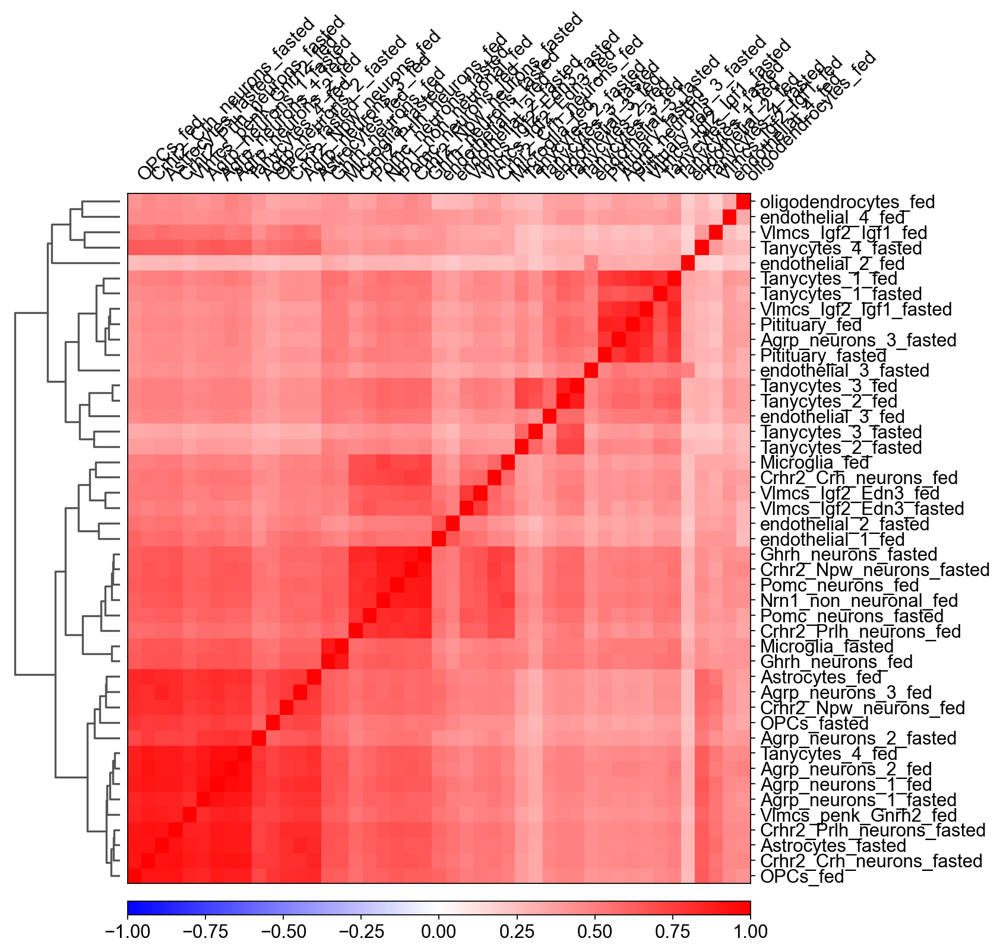

In [127]:
sc.pl.correlation_matrix(adata_down,groupby='cell_types_condition',figsize=[10,10]
                         ,dendrogram ='dendogram_neuropeptide_genes_all_leiden_condition',
                        save='_tomcells_down_celltypes_dendogram_neuropeptide_genes_all_leiden_condition.pdf')

###### save the dataset

In [128]:
results_file_down

'../rawdata/Lepr_hypothalamus_tomcells_down_analysis.h5ad'

<div class="alert alert-block alert-success">

Save the datasets for later use. Continute with 'Kakava_scLepr_analysis_neurons_nonneurons.ipynb'
</div>    

In [129]:
adata_down.write(results_file_down)
adata.write(results_file)

<div class="alert alert-block alert-warning">

Alternatively, proceed to the pyscenic analysis (TO BE UPLOADED)
</div>    